# Implementing a Neural Network
In this exercise we will develop a neural network with fully-connected layers to perform classification, and test it out on the CIFAR-10 dataset.

In [1]:
# A bit of setup

import numpy as np
import matplotlib.pyplot as plt

from cs231n.classifiers.neural_net import TwoLayerNet

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
  #print np.abs(x-y)
  #print np.abs(x) + np.abs(y)
  """ returns relative error """
  return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

We will use the class `TwoLayerNet` in the file `cs231n/classifiers/neural_net.py` to represent instances of our network. The network parameters are stored in the instance variable `self.params` where keys are string parameter names and values are numpy arrays. Below, we initialize toy data and a toy model that we will use to develop your implementation.

In [2]:
# Create a small net and some toy data to check your implementations.
# Note that we set the random seed for repeatable experiments.

input_size = 4
hidden_size = 10
num_classes = 3
num_inputs = 5

def init_toy_model():
  np.random.seed(0)
  return TwoLayerNet(input_size, hidden_size, num_classes, std=1e-1)

def init_toy_data():
  np.random.seed(1)
  X = 10 * np.random.randn(num_inputs, input_size)
  y = np.array([0, 1, 2, 2, 1])
  return X, y

net = init_toy_model()
X, y = init_toy_data()

# Forward pass: compute scores
Open the file `cs231n/classifiers/neural_net.py` and look at the method `TwoLayerNet.loss`. This function is very similar to the loss functions you have written for the SVM and Softmax exercises: It takes the data and weights and computes the class scores, the loss, and the gradients on the parameters. 

Implement the first part of the forward pass which uses the weights and biases to compute the scores for all inputs.

In [3]:
scores = net.loss(X)
print 'Your scores:'
print scores
print
print 'correct scores:'
correct_scores = np.asarray([
  [-0.81233741, -1.27654624, -0.70335995],
  [-0.17129677, -1.18803311, -0.47310444],
  [-0.51590475, -1.01354314, -0.8504215 ],
  [-0.15419291, -0.48629638, -0.52901952],
  [-0.00618733, -0.12435261, -0.15226949]])
print correct_scores
print

# The difference should be very small. We get < 1e-7
print 'Difference between your scores and correct scores:'
print np.sum(np.abs(scores - correct_scores))

Your scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

correct scores:
[[-0.81233741 -1.27654624 -0.70335995]
 [-0.17129677 -1.18803311 -0.47310444]
 [-0.51590475 -1.01354314 -0.8504215 ]
 [-0.15419291 -0.48629638 -0.52901952]
 [-0.00618733 -0.12435261 -0.15226949]]

Difference between your scores and correct scores:
3.68027207103e-08


# Forward pass: compute loss
In the same function, implement the second part that computes the data and regularizaion loss.

In [4]:
loss, _ = net.loss(X, y, reg=0.1)
correct_loss = 1.30378789133

# should be very small, we get < 1e-12
print 'Difference between your loss and correct loss:'
print np.sum(np.abs(loss - correct_loss))

Difference between your loss and correct loss:
1.79412040779e-13


# Backward pass
Implement the rest of the function. This will compute the gradient of the loss with respect to the variables `W1`, `b1`, `W2`, and `b2`. Now that you (hopefully!) have a correctly implemented forward pass, you can debug your backward pass using a numeric gradient check:

In [5]:
from cs231n.gradient_check import eval_numerical_gradient

# Use numeric gradient checking to check your implementation of the backward pass.
# If your implementation is correct, the difference between the numeric and
# analytic gradients should be less than 1e-8 for each of W1, W2, b1, and b2.

loss, grads = net.loss(X, y, reg=0.1)

# these should all be less than 1e-8 or so
for param_name in grads:
  f = lambda W: net.loss(X, y, reg=0.1)[0]
  param_grad_num = eval_numerical_gradient(f, net.params[param_name], verbose=False)
  print '%s max relative error: %e' % (param_name, rel_error(param_grad_num, grads[param_name]))

W1 max relative error: 3.561318e-09
W2 max relative error: 3.440708e-09
b2 max relative error: 4.447625e-11
b1 max relative error: 2.738421e-09


# Train the network
To train the network we will use stochastic gradient descent (SGD), similar to the SVM and Softmax classifiers. Look at the function `TwoLayerNet.train` and fill in the missing sections to implement the training procedure. This should be very similar to the training procedure you used for the SVM and Softmax classifiers. You will also have to implement `TwoLayerNet.predict`, as the training process periodically performs prediction to keep track of accuracy over time while the network trains.

Once you have implemented the method, run the code below to train a two-layer network on toy data. You should achieve a training loss less than 0.2.

Final training loss:  0.0171496079387


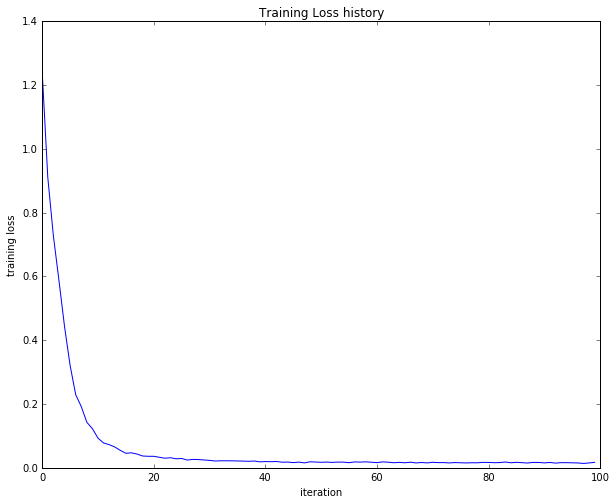

In [6]:
net = init_toy_model()
stats = net.train(X, y, X, y,
            learning_rate=1e-1, reg=1e-5,
            num_iters=100, verbose=False)

print 'Final training loss: ', stats['loss_history'][-1]

# plot the loss history
plt.plot(stats['loss_history'])
plt.xlabel('iteration')
plt.ylabel('training loss')
plt.title('Training Loss history')
plt.show()

# Load the data
Now that you have implemented a two-layer network that passes gradient checks and works on toy data, it's time to load up our favorite CIFAR-10 data so we can use it to train a classifier on a real dataset.

In [7]:
from cs231n.data_utils import load_CIFAR10

def get_CIFAR10_data(num_training=49000, num_validation=1000, num_test=1000):
    """
    Load the CIFAR-10 dataset from disk and perform preprocessing to prepare
    it for the two-layer neural net classifier. These are the same steps as
    we used for the SVM, but condensed to a single function.  
    """
    # Load the raw CIFAR-10 data
    cifar10_dir = 'cs231n/datasets/cifar-10-batches-py'
    X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)
        
    # Subsample the data
    mask = range(num_training, num_training + num_validation)
    X_val = X_train[mask]
    y_val = y_train[mask]
    mask = range(num_training)
    X_train = X_train[mask]
    y_train = y_train[mask]
    mask = range(num_test)
    X_test = X_test[mask]
    y_test = y_test[mask]

    # Normalize the data: subtract the mean image
    mean_image = np.mean(X_train, axis=0)
    X_train -= mean_image
    X_val -= mean_image
    X_test -= mean_image

    # Reshape data to rows
    X_train = X_train.reshape(num_training, -1)
    X_val = X_val.reshape(num_validation, -1)
    X_test = X_test.reshape(num_test, -1)

    return X_train, y_train, X_val, y_val, X_test, y_test


# Invoke the above function to get our data.
X_train, y_train, X_val, y_val, X_test, y_test = get_CIFAR10_data()
print 'Train data shape: ', X_train.shape
print 'Train labels shape: ', y_train.shape
print 'Validation data shape: ', X_val.shape
print 'Validation labels shape: ', y_val.shape
print 'Test data shape: ', X_test.shape
print 'Test labels shape: ', y_test.shape

Train data shape:  (49000, 3072)
Train labels shape:  (49000,)
Validation data shape:  (1000, 3072)
Validation labels shape:  (1000,)
Test data shape:  (1000, 3072)
Test labels shape:  (1000,)


# Train a network
To train our network we will use SGD with momentum. In addition, we will adjust the learning rate with an exponential learning rate schedule as optimization proceeds; after each epoch, we will reduce the learning rate by multiplying it by a decay rate.

In [8]:
input_size = 32 * 32 * 3
hidden_size = 50
num_classes = 10
net = TwoLayerNet(input_size, hidden_size, num_classes)

# Train the network
stats = net.train(X_train, y_train, X_val, y_val,
            num_iters=1000, batch_size=200,
            learning_rate=1e-4, learning_rate_decay=0.95,
            reg=0.5, verbose=True)

# Predict on the validation set
val_acc = (net.predict(X_val) == y_val).mean()
print 'Validation accuracy: ', val_acc

iteration 0 / 1000: loss 2.302954
iteration 100 / 1000: loss 2.302550
iteration 200 / 1000: loss 2.297648
iteration 300 / 1000: loss 2.259602
iteration 400 / 1000: loss 2.204170
iteration 500 / 1000: loss 2.118565
iteration 600 / 1000: loss 2.051535
iteration 700 / 1000: loss 1.988466
iteration 800 / 1000: loss 2.006591
iteration 900 / 1000: loss 1.951473
Validation accuracy:  0.287


# Debug the training
With the default parameters we provided above, you should get a validation accuracy of about 0.29 on the validation set. This isn't very good.

One strategy for getting insight into what's wrong is to plot the loss function and the accuracies on the training and validation sets during optimization.

Another strategy is to visualize the weights that were learned in the first layer of the network. In most neural networks trained on visual data, the first layer weights typically show some visible structure when visualized.

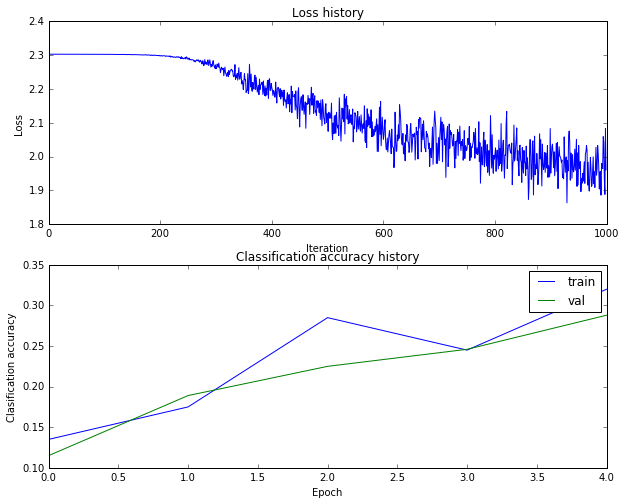

In [9]:
# Plot the loss function and train / validation accuracies
plt.subplot(2, 1, 1)
plt.plot(stats['loss_history'])
plt.title('Loss history')
plt.xlabel('Iteration')
plt.ylabel('Loss')

plt.subplot(2, 1, 2)
plt.plot(stats['train_acc_history'], label='train')
plt.plot(stats['val_acc_history'], label='val')
plt.title('Classification accuracy history')
plt.xlabel('Epoch')
plt.ylabel('Clasification accuracy')
plt.legend()
plt.show()

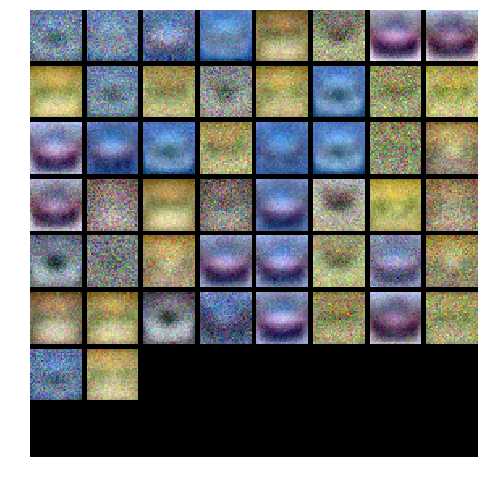

In [10]:
from cs231n.vis_utils import visualize_grid

# Visualize the weights of the network

def show_net_weights(net):
  W1 = net.params['W1']
  W1 = W1.reshape(32, 32, 3, -1).transpose(3, 0, 1, 2)
  plt.imshow(visualize_grid(W1, padding=3).astype('uint8'))
  plt.gca().axis('off')
  plt.show()

show_net_weights(net)

# Tune your hyperparameters

**What's wrong?**. Looking at the visualizations above, we see that the loss is decreasing more or less linearly, which seems to suggest that the learning rate may be too low. Moreover, there is no gap between the training and validation accuracy, suggesting that the model we used has low capacity, and that we should increase its size. On the other hand, with a very large model we would expect to see more overfitting, which would manifest itself as a very large gap between the training and validation accuracy.

**Tuning**. Tuning the hyperparameters and developing intuition for how they affect the final performance is a large part of using Neural Networks, so we want you to get a lot of practice. Below, you should experiment with different values of the various hyperparameters, including hidden layer size, learning rate, numer of training epochs, and regularization strength. You might also consider tuning the learning rate decay, but you should be able to get good performance using the default value.

**Approximate results**. You should be aim to achieve a classification accuracy of greater than 48% on the validation set. Our best network gets over 52% on the validation set.

**Experiment**: You goal in this exercise is to get as good of a result on CIFAR-10 as you can, with a fully-connected Neural Network. For every 1% above 52% on the Test set we will award you with one extra bonus point. Feel free implement your own techniques (e.g. PCA to reduce dimensionality, or adding dropout, or adding features to the solver, etc.).

Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 1000
                           and batch size = 50
iteration 0 / 1000: loss 2.302640
iteration 100 / 1000: loss 2.002306
iteration 200 / 1000: loss 1.981217
iteration 300 / 1000: loss 1.769364
iteration 400 / 1000: loss 1.614104
iteration 500 / 1000: loss 1.500050
iteration 600 / 1000: loss 1.925271
iteration 700 / 1000: loss 1.832307
iteration 800 / 1000: loss 1.650104
iteration 900 / 1000: loss 1.675206


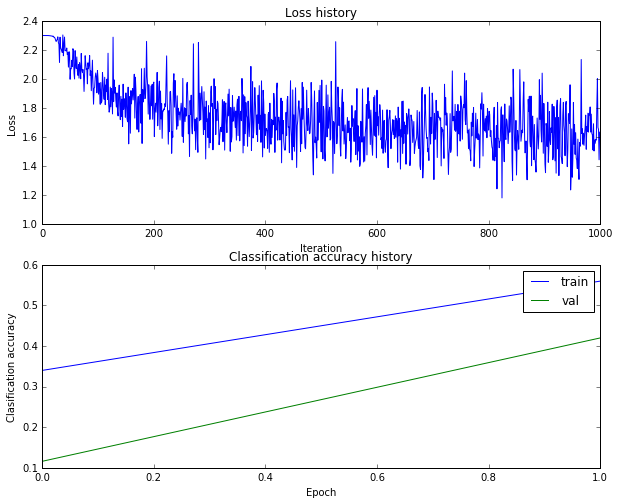

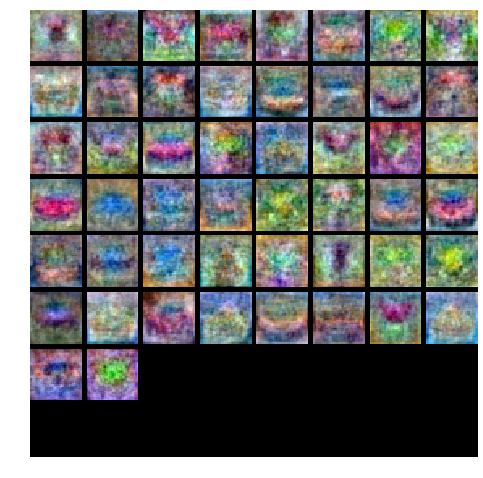

Validation accuracy:  0.426
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 1000
                           and batch size = 100
iteration 0 / 1000: loss 2.302656
iteration 100 / 1000: loss 2.033336
iteration 200 / 1000: loss 1.785281
iteration 300 / 1000: loss 1.772432
iteration 400 / 1000: loss 1.665984
iteration 500 / 1000: loss 1.739578
iteration 600 / 1000: loss 1.548239
iteration 700 / 1000: loss 1.801513
iteration 800 / 1000: loss 1.307353
iteration 900 / 1000: loss 1.404143


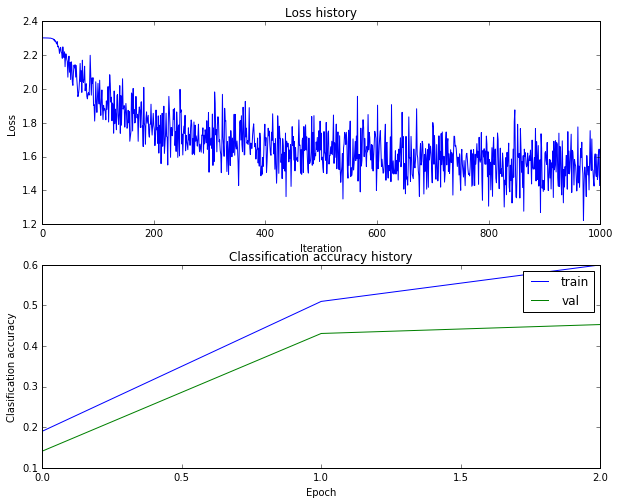

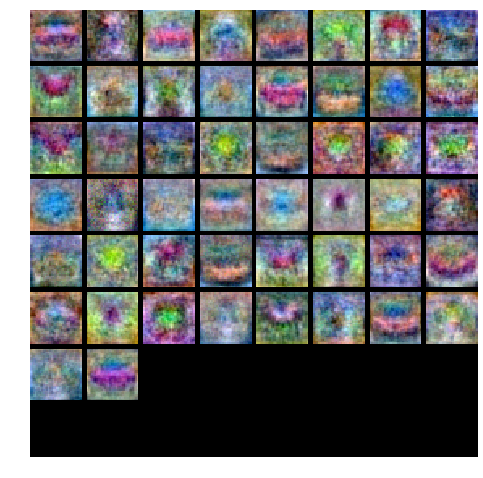

Validation accuracy:  0.449
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 1000
                           and batch size = 200
iteration 0 / 1000: loss 2.302655
iteration 100 / 1000: loss 1.950576
iteration 200 / 1000: loss 1.881766
iteration 300 / 1000: loss 1.705056
iteration 400 / 1000: loss 1.679944
iteration 500 / 1000: loss 1.713169
iteration 600 / 1000: loss 1.572203
iteration 700 / 1000: loss 1.515215
iteration 800 / 1000: loss 1.621652
iteration 900 / 1000: loss 1.469045


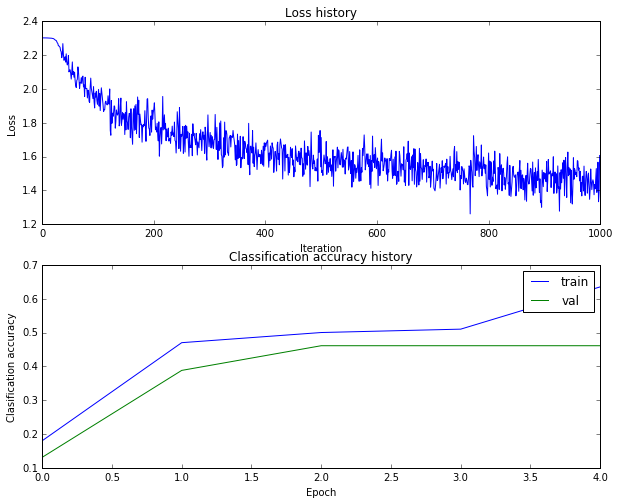

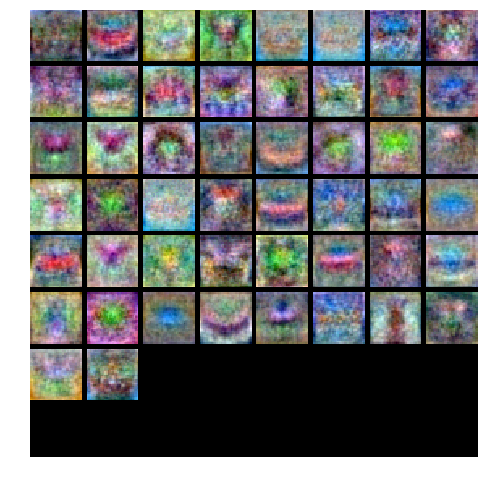

Validation accuracy:  0.483
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 1000
                           and batch size = 300
iteration 0 / 1000: loss 2.302644
iteration 100 / 1000: loss 1.878099
iteration 200 / 1000: loss 1.675367
iteration 300 / 1000: loss 1.686704
iteration 400 / 1000: loss 1.640950
iteration 500 / 1000: loss 1.531890
iteration 600 / 1000: loss 1.508902
iteration 700 / 1000: loss 1.577757
iteration 800 / 1000: loss 1.566717
iteration 900 / 1000: loss 1.514370


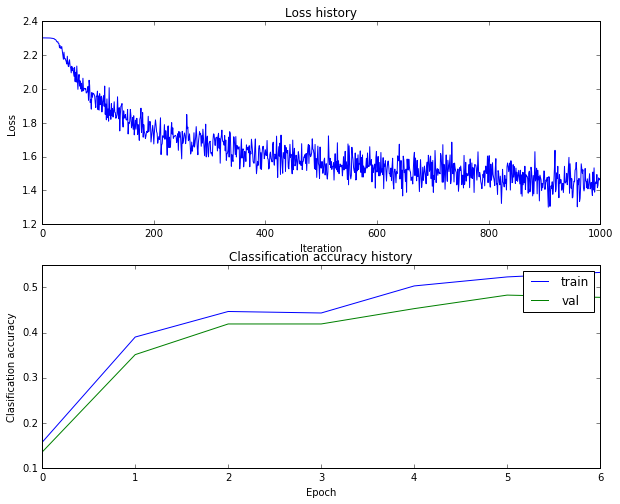

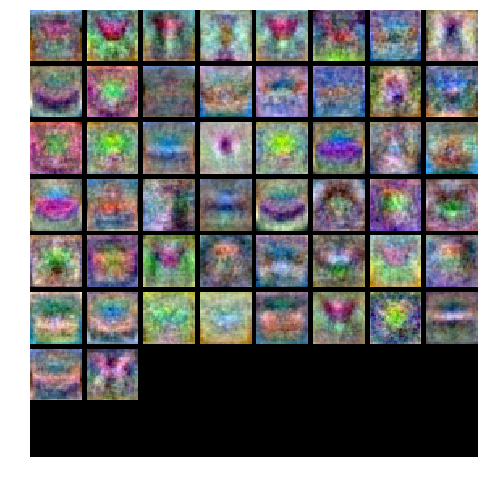

Validation accuracy:  0.49
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 1000
                           and batch size = 400
iteration 0 / 1000: loss 2.302672
iteration 100 / 1000: loss 1.898860
iteration 200 / 1000: loss 1.698038
iteration 300 / 1000: loss 1.616058
iteration 400 / 1000: loss 1.513923
iteration 500 / 1000: loss 1.572299
iteration 600 / 1000: loss 1.540481
iteration 700 / 1000: loss 1.443506
iteration 800 / 1000: loss 1.477396
iteration 900 / 1000: loss 1.471849


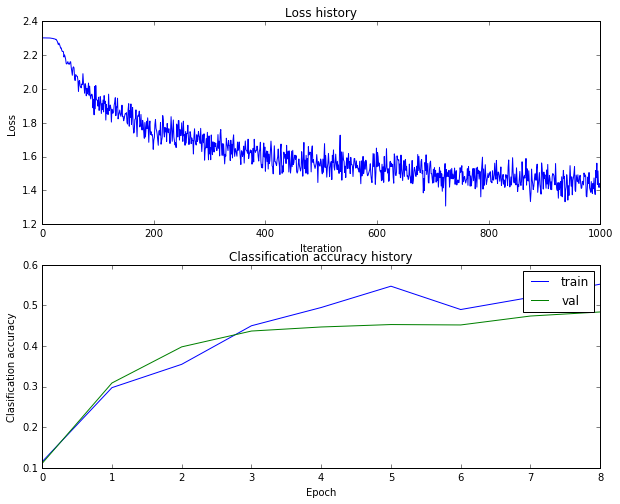

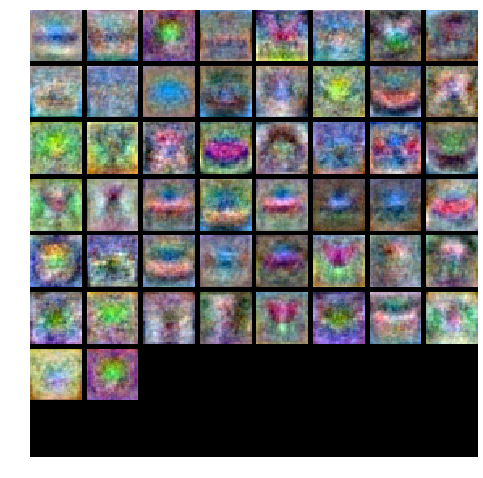

Validation accuracy:  0.483
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 1000
                           and batch size = 500
iteration 0 / 1000: loss 2.302670
iteration 100 / 1000: loss 1.913079
iteration 200 / 1000: loss 1.750275
iteration 300 / 1000: loss 1.723678
iteration 400 / 1000: loss 1.574005
iteration 500 / 1000: loss 1.549701
iteration 600 / 1000: loss 1.599290
iteration 700 / 1000: loss 1.531763
iteration 800 / 1000: loss 1.535843
iteration 900 / 1000: loss 1.444727


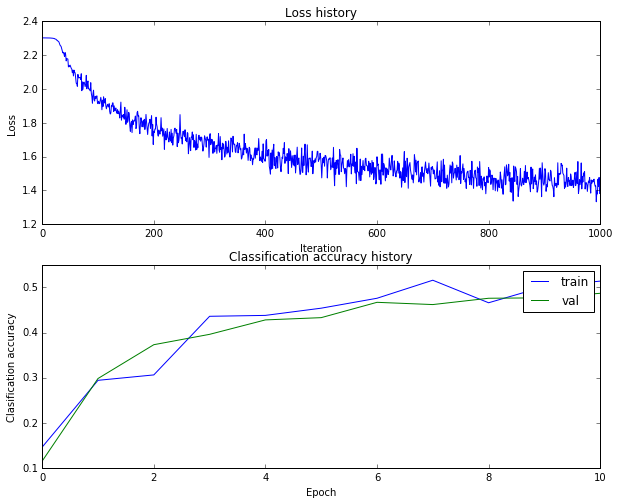

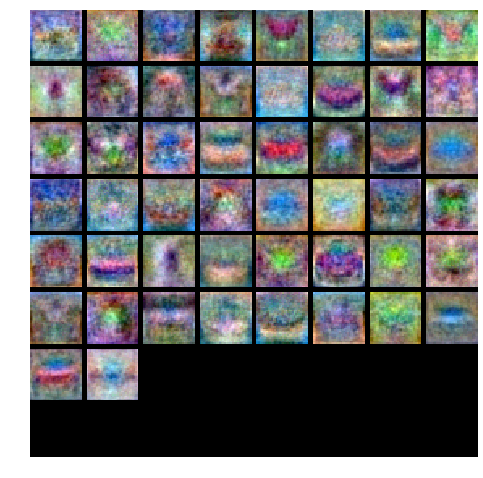

Validation accuracy:  0.494
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 3000
                           and batch size = 50
iteration 0 / 3000: loss 2.302721
iteration 100 / 3000: loss 1.815825
iteration 200 / 3000: loss 1.762694
iteration 300 / 3000: loss 1.764226
iteration 400 / 3000: loss 1.723476
iteration 500 / 3000: loss 1.520462
iteration 600 / 3000: loss 1.699813
iteration 700 / 3000: loss 1.887682
iteration 800 / 3000: loss 1.619681
iteration 900 / 3000: loss 1.717605
iteration 1000 / 3000: loss 1.917815
iteration 1100 / 3000: loss 1.618352
iteration 1200 / 3000: loss 1.652518
iteration 1300 / 3000: loss 1.833454
iteration 1400 / 3000: loss 1.231040
iteration 1500 / 3000: loss 1.872796
iteration 1600 / 3000: loss 1.629681
iteration 1700 / 3000: loss 1.525273
iteration 1800 / 3000: loss 1.585038
iteration 1900 / 3000: loss 1.739970
iteration 2000 / 3000: loss 1.374322
iteration

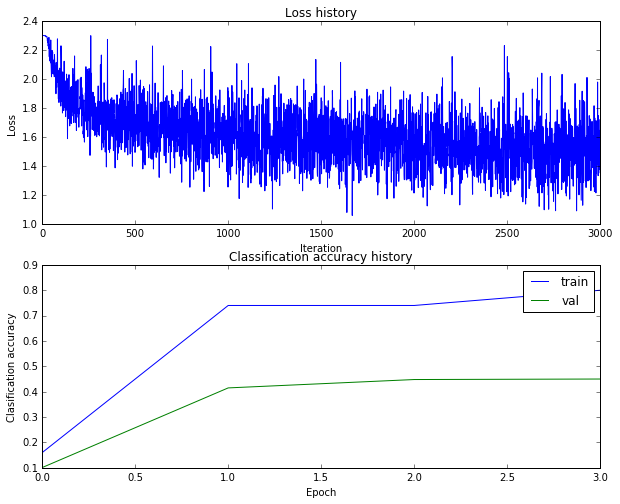

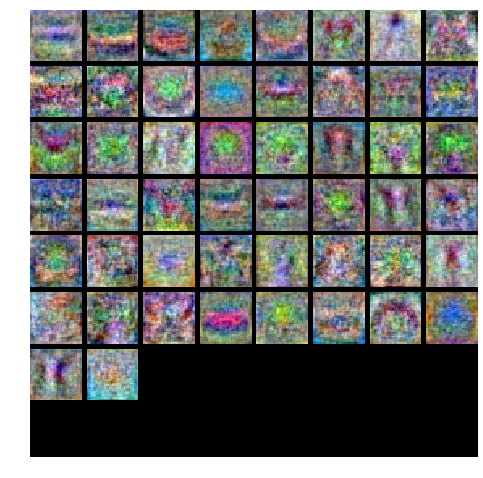

Validation accuracy:  0.467
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 3000
                           and batch size = 100
iteration 0 / 3000: loss 2.302639
iteration 100 / 3000: loss 1.929244
iteration 200 / 3000: loss 1.941166
iteration 300 / 3000: loss 1.737611
iteration 400 / 3000: loss 1.542634
iteration 500 / 3000: loss 1.622926
iteration 600 / 3000: loss 1.538164
iteration 700 / 3000: loss 1.625221
iteration 800 / 3000: loss 1.660286
iteration 900 / 3000: loss 1.435327
iteration 1000 / 3000: loss 1.315876
iteration 1100 / 3000: loss 1.417600
iteration 1200 / 3000: loss 1.368890
iteration 1300 / 3000: loss 1.461392
iteration 1400 / 3000: loss 1.203540
iteration 1500 / 3000: loss 1.487632
iteration 1600 / 3000: loss 1.547136
iteration 1700 / 3000: loss 1.462952
iteration 1800 / 3000: loss 1.446216
iteration 1900 / 3000: loss 1.587457
iteration 2000 / 3000: loss 1.405902
iteratio

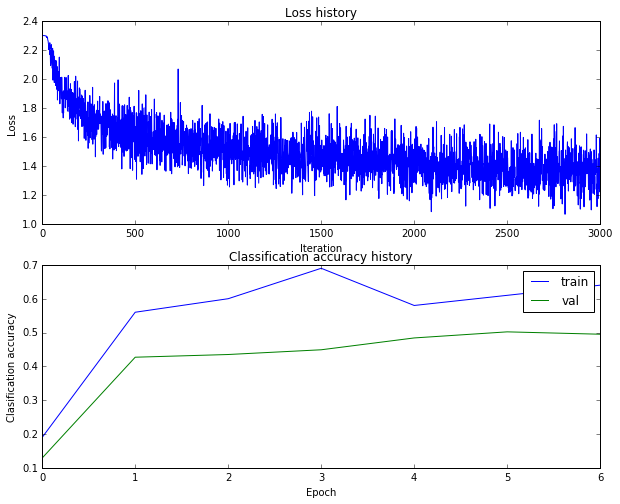

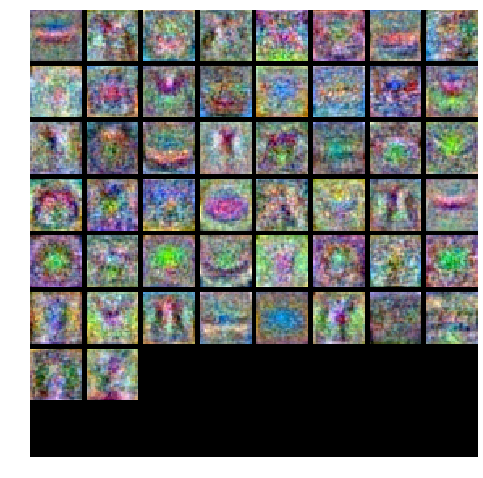

Validation accuracy:  0.496
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.302640
iteration 100 / 3000: loss 1.957364
iteration 200 / 3000: loss 1.764168
iteration 300 / 3000: loss 1.696539
iteration 400 / 3000: loss 1.591796
iteration 500 / 3000: loss 1.501227
iteration 600 / 3000: loss 1.609058
iteration 700 / 3000: loss 1.403461
iteration 800 / 3000: loss 1.459190
iteration 900 / 3000: loss 1.453954
iteration 1000 / 3000: loss 1.507479
iteration 1100 / 3000: loss 1.362892
iteration 1200 / 3000: loss 1.373141
iteration 1300 / 3000: loss 1.332121
iteration 1400 / 3000: loss 1.454871
iteration 1500 / 3000: loss 1.473954
iteration 1600 / 3000: loss 1.311080
iteration 1700 / 3000: loss 1.331459
iteration 1800 / 3000: loss 1.359103
iteration 1900 / 3000: loss 1.245297
iteration 2000 / 3000: loss 1.507895
iteratio

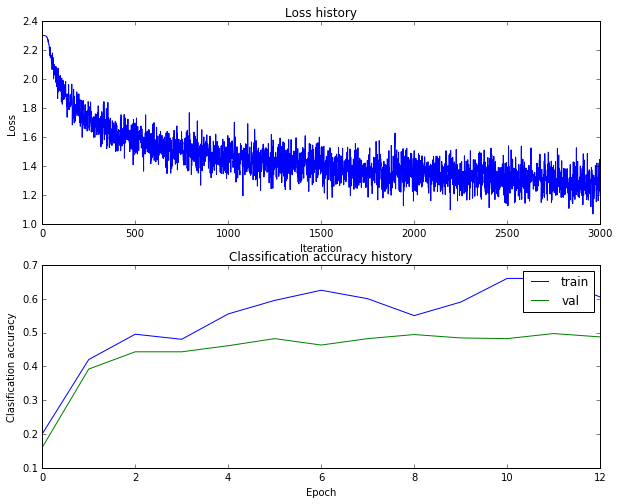

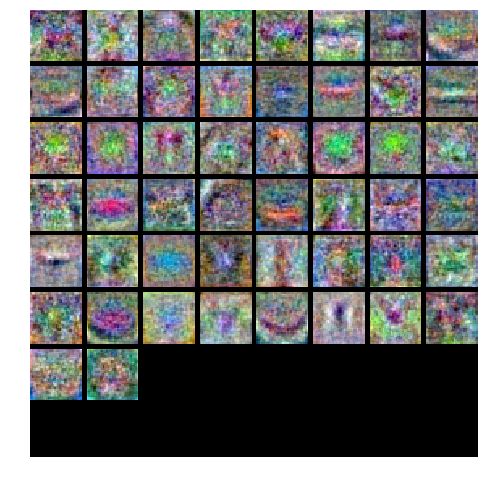

Validation accuracy:  0.504
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.302658
iteration 100 / 3000: loss 1.942595
iteration 200 / 3000: loss 1.738497
iteration 300 / 3000: loss 1.658110
iteration 400 / 3000: loss 1.571947
iteration 500 / 3000: loss 1.566667
iteration 600 / 3000: loss 1.560546
iteration 700 / 3000: loss 1.419917
iteration 800 / 3000: loss 1.481202
iteration 900 / 3000: loss 1.487855
iteration 1000 / 3000: loss 1.446986
iteration 1100 / 3000: loss 1.460746
iteration 1200 / 3000: loss 1.431098
iteration 1300 / 3000: loss 1.339592
iteration 1400 / 3000: loss 1.374160
iteration 1500 / 3000: loss 1.318219
iteration 1600 / 3000: loss 1.414928
iteration 1700 / 3000: loss 1.277491
iteration 1800 / 3000: loss 1.374969
iteration 1900 / 3000: loss 1.255066
iteration 2000 / 3000: loss 1.456383
iteratio

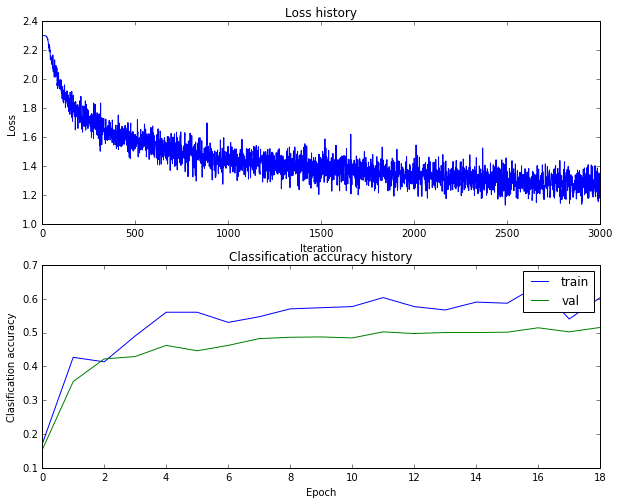

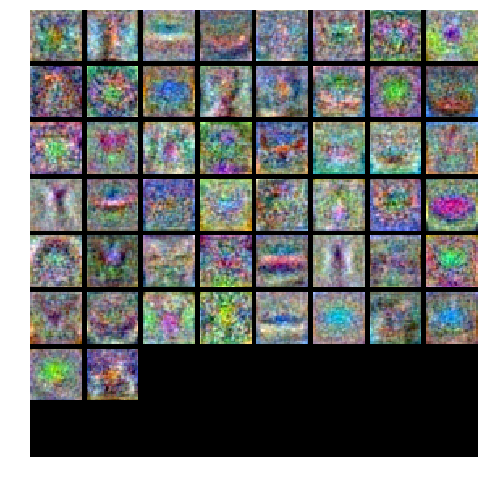

Validation accuracy:  0.5
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.302640
iteration 100 / 3000: loss 1.896645
iteration 200 / 3000: loss 1.651252
iteration 300 / 3000: loss 1.640937
iteration 400 / 3000: loss 1.649351
iteration 500 / 3000: loss 1.500916
iteration 600 / 3000: loss 1.549123
iteration 700 / 3000: loss 1.550854
iteration 800 / 3000: loss 1.498156
iteration 900 / 3000: loss 1.381905
iteration 1000 / 3000: loss 1.436031
iteration 1100 / 3000: loss 1.445558
iteration 1200 / 3000: loss 1.447446
iteration 1300 / 3000: loss 1.450194
iteration 1400 / 3000: loss 1.372934
iteration 1500 / 3000: loss 1.363713
iteration 1600 / 3000: loss 1.383248
iteration 1700 / 3000: loss 1.384530
iteration 1800 / 3000: loss 1.385127
iteration 1900 / 3000: loss 1.313505
iteration 2000 / 3000: loss 1.362909
iteration 

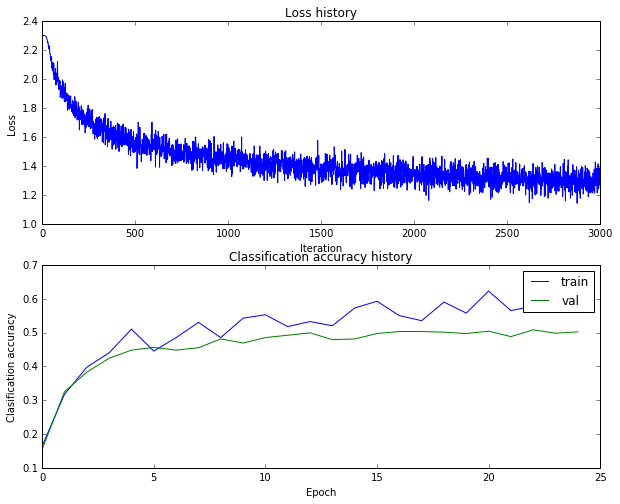

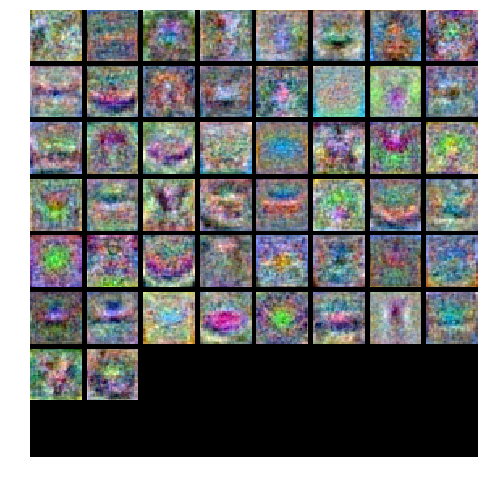

Validation accuracy:  0.5
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 50 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.302685
iteration 100 / 3000: loss 1.955087
iteration 200 / 3000: loss 1.781839
iteration 300 / 3000: loss 1.601421
iteration 400 / 3000: loss 1.596982
iteration 500 / 3000: loss 1.554863
iteration 600 / 3000: loss 1.460764
iteration 700 / 3000: loss 1.457247
iteration 800 / 3000: loss 1.433595
iteration 900 / 3000: loss 1.418373
iteration 1000 / 3000: loss 1.459639
iteration 1100 / 3000: loss 1.370712
iteration 1200 / 3000: loss 1.335493
iteration 1300 / 3000: loss 1.375934
iteration 1400 / 3000: loss 1.336335
iteration 1500 / 3000: loss 1.310069
iteration 1600 / 3000: loss 1.366894
iteration 1700 / 3000: loss 1.316704
iteration 1800 / 3000: loss 1.392846
iteration 1900 / 3000: loss 1.345472
iteration 2000 / 3000: loss 1.303897
iteration 

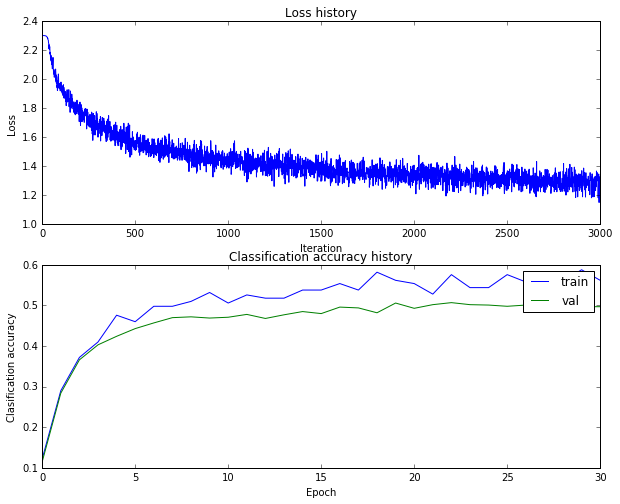

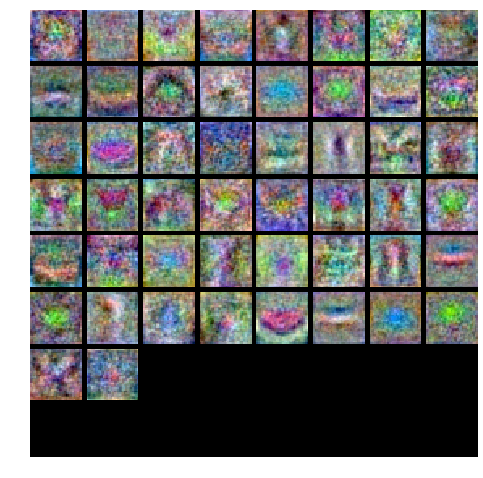

Validation accuracy:  0.503
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 1000
                           and batch size = 50
iteration 0 / 1000: loss 2.302759
iteration 100 / 1000: loss 1.954750
iteration 200 / 1000: loss 1.649579
iteration 300 / 1000: loss 1.631170
iteration 400 / 1000: loss 1.588795
iteration 500 / 1000: loss 1.850620
iteration 600 / 1000: loss 1.934258
iteration 700 / 1000: loss 1.542804
iteration 800 / 1000: loss 1.540398
iteration 900 / 1000: loss 1.753885


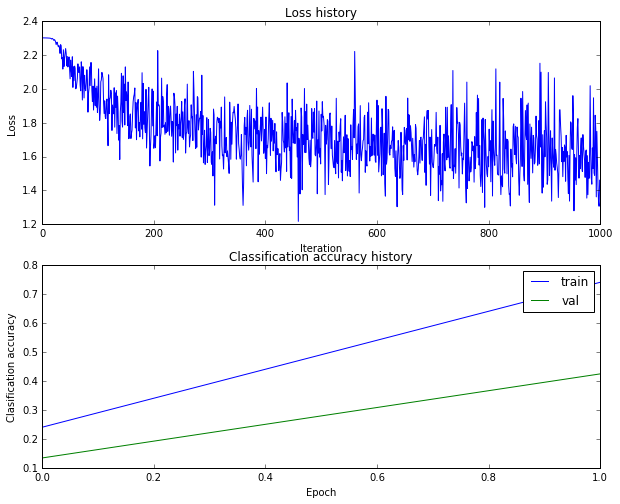

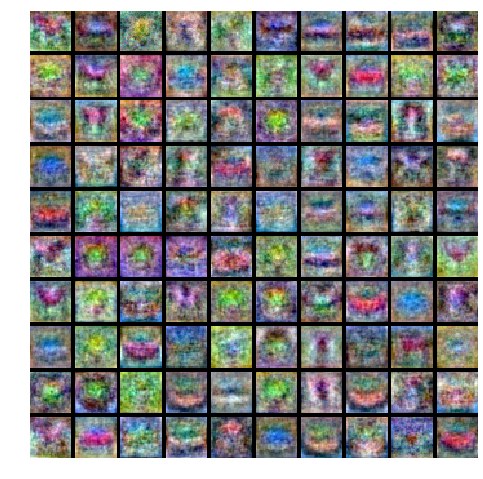

Validation accuracy:  0.448
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 1000
                           and batch size = 100
iteration 0 / 1000: loss 2.302731
iteration 100 / 1000: loss 1.976437
iteration 200 / 1000: loss 2.016823
iteration 300 / 1000: loss 1.681216
iteration 400 / 1000: loss 1.648493
iteration 500 / 1000: loss 1.578631
iteration 600 / 1000: loss 1.584848
iteration 700 / 1000: loss 1.507338
iteration 800 / 1000: loss 1.465863
iteration 900 / 1000: loss 1.474063


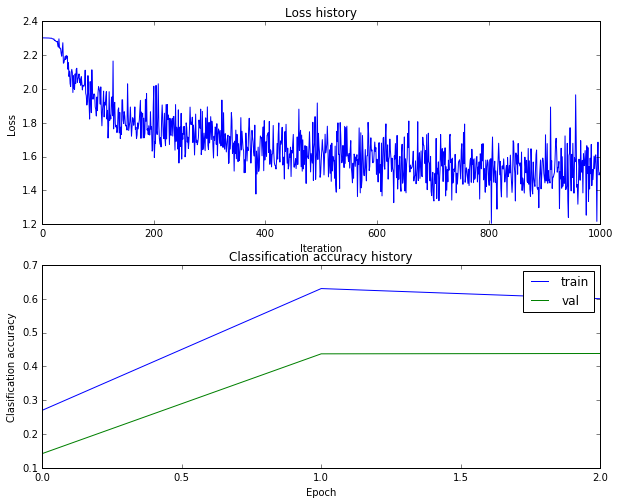

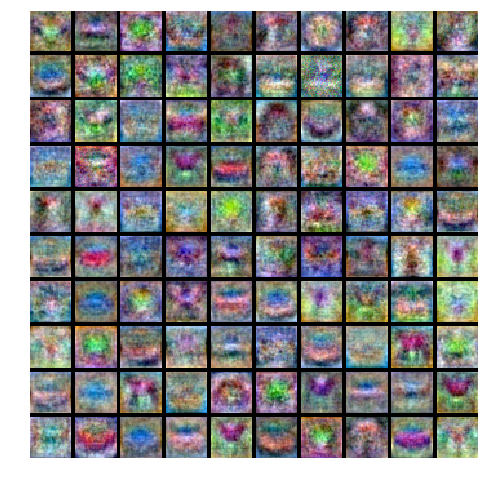

Validation accuracy:  0.475
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 1000
                           and batch size = 200
iteration 0 / 1000: loss 2.302742
iteration 100 / 1000: loss 1.916603
iteration 200 / 1000: loss 1.665185
iteration 300 / 1000: loss 1.733544
iteration 400 / 1000: loss 1.637834
iteration 500 / 1000: loss 1.559720
iteration 600 / 1000: loss 1.445353
iteration 700 / 1000: loss 1.442725
iteration 800 / 1000: loss 1.469249
iteration 900 / 1000: loss 1.408315


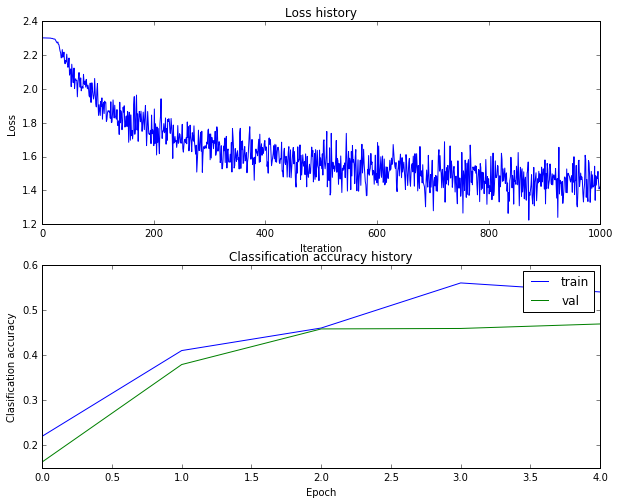

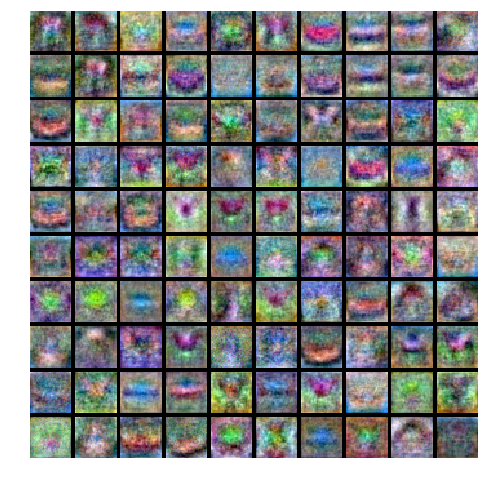

Validation accuracy:  0.488
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 1000
                           and batch size = 300
iteration 0 / 1000: loss 2.302726
iteration 100 / 1000: loss 1.956295
iteration 200 / 1000: loss 1.824404
iteration 300 / 1000: loss 1.600109
iteration 400 / 1000: loss 1.486396
iteration 500 / 1000: loss 1.486355
iteration 600 / 1000: loss 1.521203
iteration 700 / 1000: loss 1.413641
iteration 800 / 1000: loss 1.497202
iteration 900 / 1000: loss 1.322434


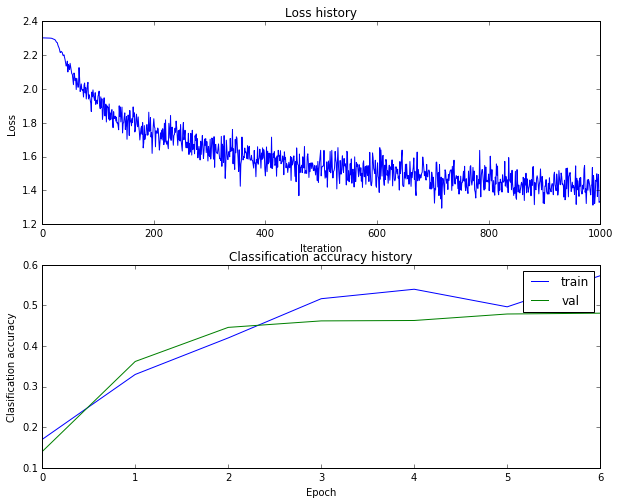

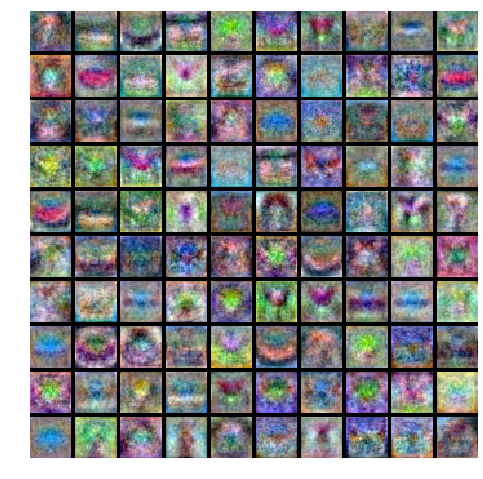

Validation accuracy:  0.478
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 1000
                           and batch size = 400
iteration 0 / 1000: loss 2.302742
iteration 100 / 1000: loss 1.897983
iteration 200 / 1000: loss 1.772639
iteration 300 / 1000: loss 1.611471
iteration 400 / 1000: loss 1.535883
iteration 500 / 1000: loss 1.512881
iteration 600 / 1000: loss 1.486166
iteration 700 / 1000: loss 1.420928
iteration 800 / 1000: loss 1.517727
iteration 900 / 1000: loss 1.477746


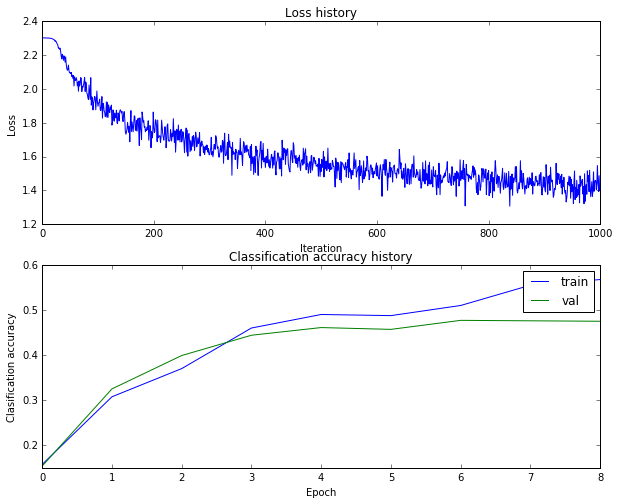

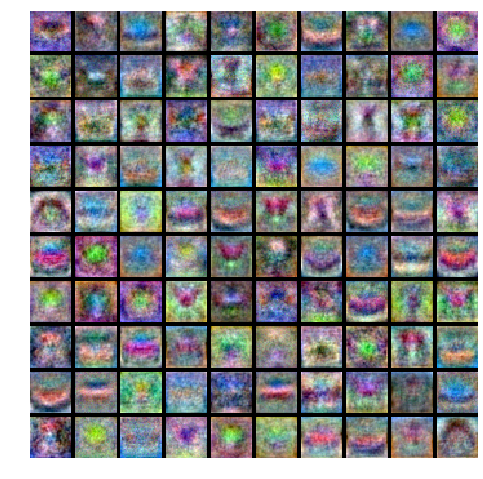

Validation accuracy:  0.489
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 1000
                           and batch size = 500
iteration 0 / 1000: loss 2.302745
iteration 100 / 1000: loss 1.929023
iteration 200 / 1000: loss 1.720431
iteration 300 / 1000: loss 1.638078
iteration 400 / 1000: loss 1.601859
iteration 500 / 1000: loss 1.609363
iteration 600 / 1000: loss 1.510253
iteration 700 / 1000: loss 1.465776
iteration 800 / 1000: loss 1.414272
iteration 900 / 1000: loss 1.346399


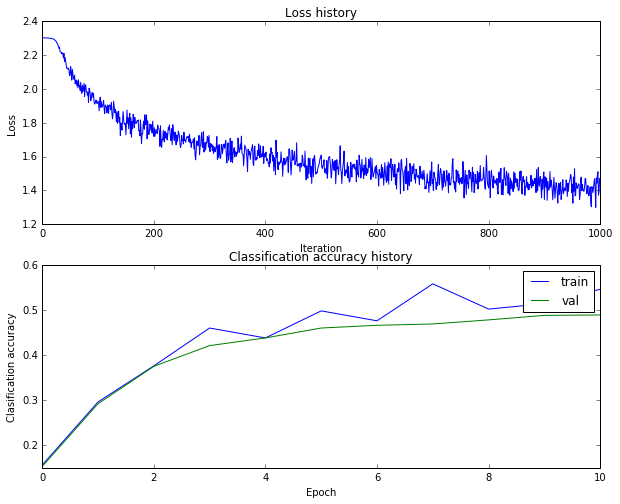

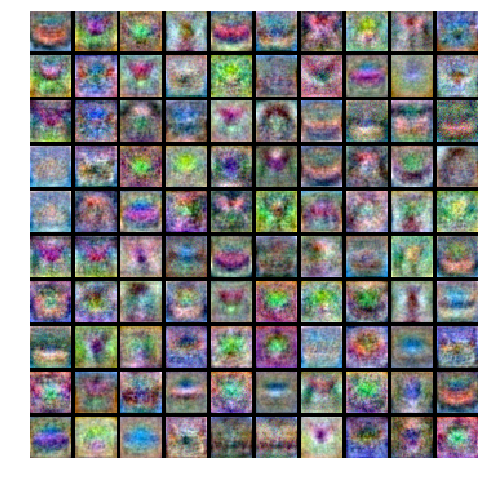

Validation accuracy:  0.486
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 3000
                           and batch size = 50
iteration 0 / 3000: loss 2.302741
iteration 100 / 3000: loss 2.038013
iteration 200 / 3000: loss 1.834204
iteration 300 / 3000: loss 1.609725
iteration 400 / 3000: loss 1.876665
iteration 500 / 3000: loss 1.654040
iteration 600 / 3000: loss 1.609033
iteration 700 / 3000: loss 1.736545
iteration 800 / 3000: loss 1.491053
iteration 900 / 3000: loss 1.787450
iteration 1000 / 3000: loss 1.739908
iteration 1100 / 3000: loss 1.507489
iteration 1200 / 3000: loss 1.402621
iteration 1300 / 3000: loss 1.652845
iteration 1400 / 3000: loss 1.586004
iteration 1500 / 3000: loss 1.534704
iteration 1600 / 3000: loss 1.821911
iteration 1700 / 3000: loss 1.531623
iteration 1800 / 3000: loss 1.472809
iteration 1900 / 3000: loss 1.995912
iteration 2000 / 3000: loss 1.661635
iteratio

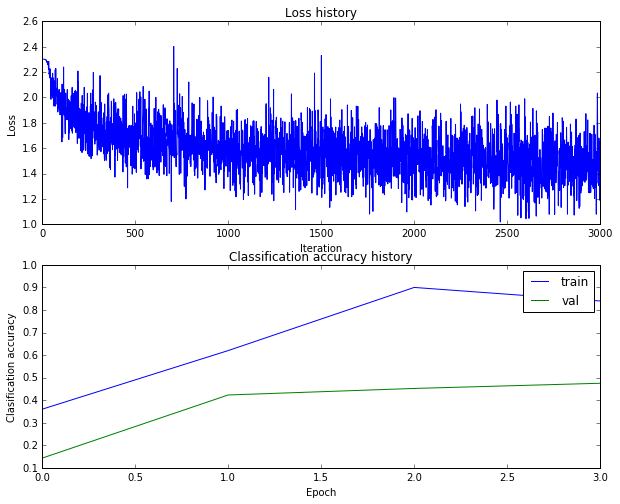

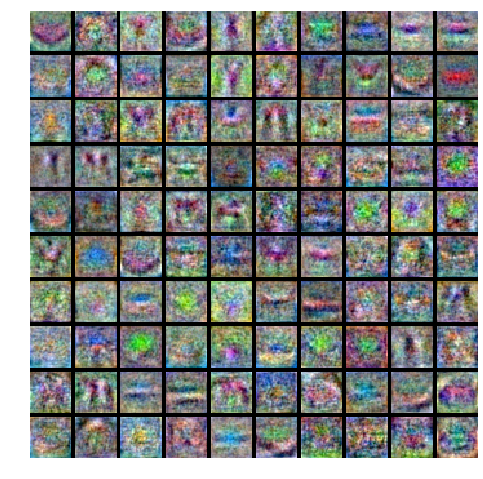

Validation accuracy:  0.477
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 3000
                           and batch size = 100
iteration 0 / 3000: loss 2.302760
iteration 100 / 3000: loss 1.939611
iteration 200 / 3000: loss 1.880609
iteration 300 / 3000: loss 1.675954
iteration 400 / 3000: loss 1.629895
iteration 500 / 3000: loss 1.679669
iteration 600 / 3000: loss 1.540418
iteration 700 / 3000: loss 1.519331
iteration 800 / 3000: loss 1.470372
iteration 900 / 3000: loss 1.386156
iteration 1000 / 3000: loss 1.570058
iteration 1100 / 3000: loss 1.318516
iteration 1200 / 3000: loss 1.496056
iteration 1300 / 3000: loss 1.526624
iteration 1400 / 3000: loss 1.439196
iteration 1500 / 3000: loss 1.373061
iteration 1600 / 3000: loss 1.489656
iteration 1700 / 3000: loss 1.293477
iteration 1800 / 3000: loss 1.414046
iteration 1900 / 3000: loss 1.389420
iteration 2000 / 3000: loss 1.358266
iterati

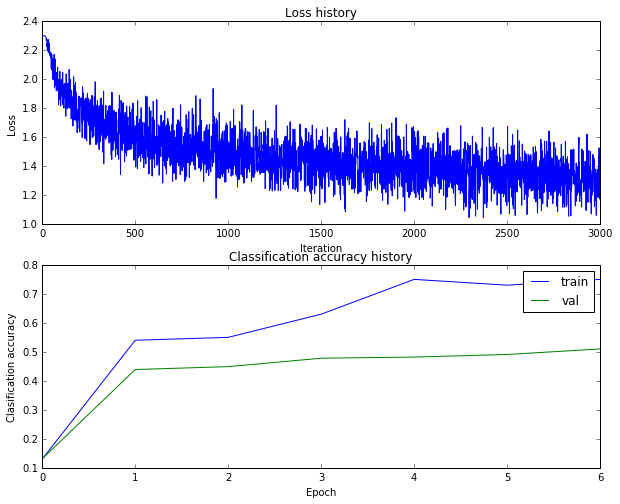

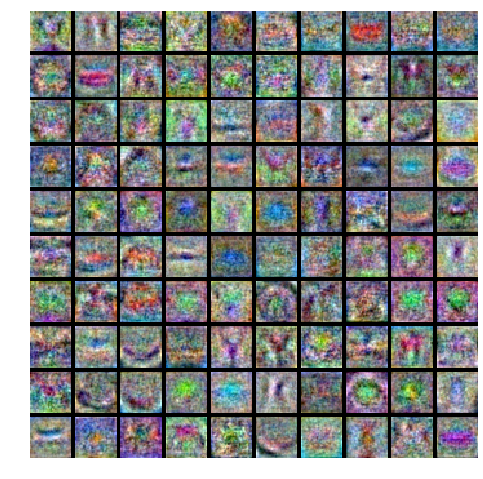

Validation accuracy:  0.514
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.302698
iteration 100 / 3000: loss 1.879861
iteration 200 / 3000: loss 1.665615
iteration 300 / 3000: loss 1.684777
iteration 400 / 3000: loss 1.640064
iteration 500 / 3000: loss 1.566168
iteration 600 / 3000: loss 1.533471
iteration 700 / 3000: loss 1.577945
iteration 800 / 3000: loss 1.465902
iteration 900 / 3000: loss 1.420916
iteration 1000 / 3000: loss 1.352434
iteration 1100 / 3000: loss 1.431651
iteration 1200 / 3000: loss 1.463133
iteration 1300 / 3000: loss 1.435135
iteration 1400 / 3000: loss 1.420485
iteration 1500 / 3000: loss 1.320597
iteration 1600 / 3000: loss 1.322737
iteration 1700 / 3000: loss 1.471613
iteration 1800 / 3000: loss 1.397013
iteration 1900 / 3000: loss 1.307912
iteration 2000 / 3000: loss 1.251608
iterati

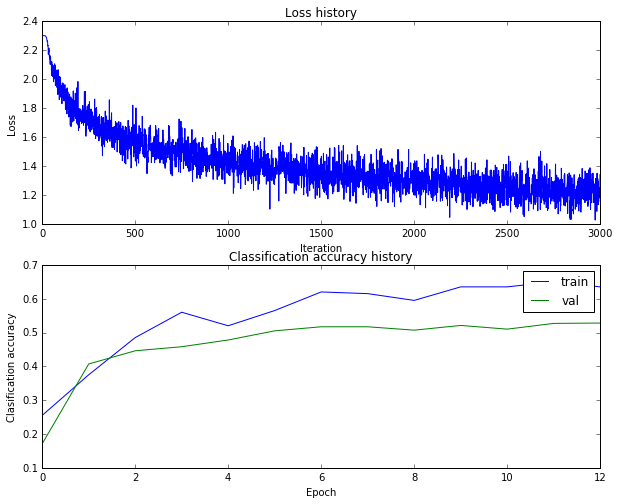

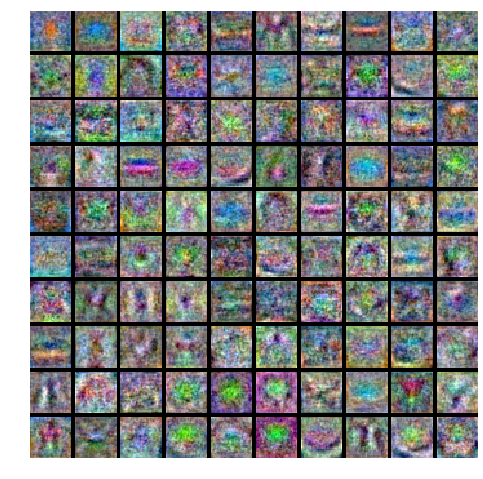

Validation accuracy:  0.505
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.302748
iteration 100 / 3000: loss 1.978498
iteration 200 / 3000: loss 1.784117
iteration 300 / 3000: loss 1.724916
iteration 400 / 3000: loss 1.615983
iteration 500 / 3000: loss 1.629044
iteration 600 / 3000: loss 1.454120
iteration 700 / 3000: loss 1.443960
iteration 800 / 3000: loss 1.582819
iteration 900 / 3000: loss 1.384816
iteration 1000 / 3000: loss 1.402971
iteration 1100 / 3000: loss 1.448086
iteration 1200 / 3000: loss 1.515297
iteration 1300 / 3000: loss 1.365462
iteration 1400 / 3000: loss 1.359950
iteration 1500 / 3000: loss 1.362508
iteration 1600 / 3000: loss 1.294272
iteration 1700 / 3000: loss 1.314856
iteration 1800 / 3000: loss 1.168794
iteration 1900 / 3000: loss 1.229932
iteration 2000 / 3000: loss 1.268906
iterati

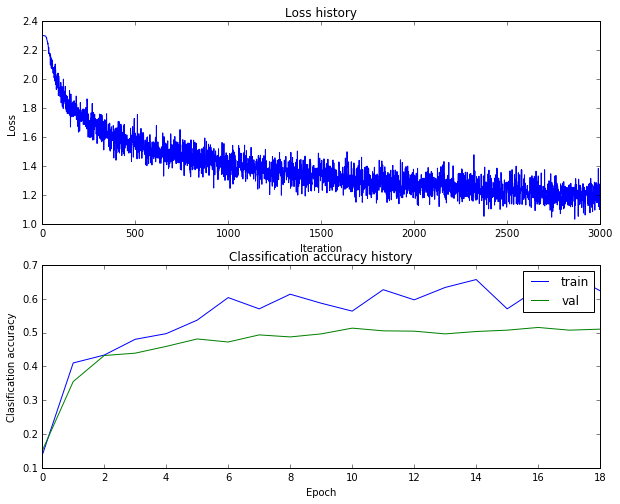

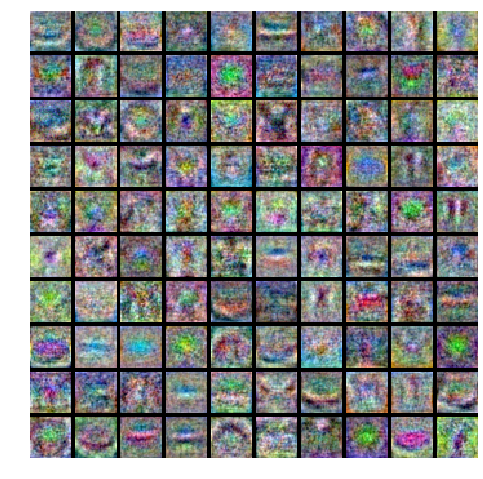

Validation accuracy:  0.52
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.302746
iteration 100 / 3000: loss 1.890136
iteration 200 / 3000: loss 1.722886
iteration 300 / 3000: loss 1.667370
iteration 400 / 3000: loss 1.603074
iteration 500 / 3000: loss 1.634297
iteration 600 / 3000: loss 1.507228
iteration 700 / 3000: loss 1.544314
iteration 800 / 3000: loss 1.525309
iteration 900 / 3000: loss 1.437668
iteration 1000 / 3000: loss 1.339747
iteration 1100 / 3000: loss 1.339078
iteration 1200 / 3000: loss 1.419843
iteration 1300 / 3000: loss 1.401775
iteration 1400 / 3000: loss 1.374466
iteration 1500 / 3000: loss 1.405171
iteration 1600 / 3000: loss 1.246978
iteration 1700 / 3000: loss 1.195004
iteration 1800 / 3000: loss 1.247941
iteration 1900 / 3000: loss 1.292829
iteration 2000 / 3000: loss 1.249169
iteratio

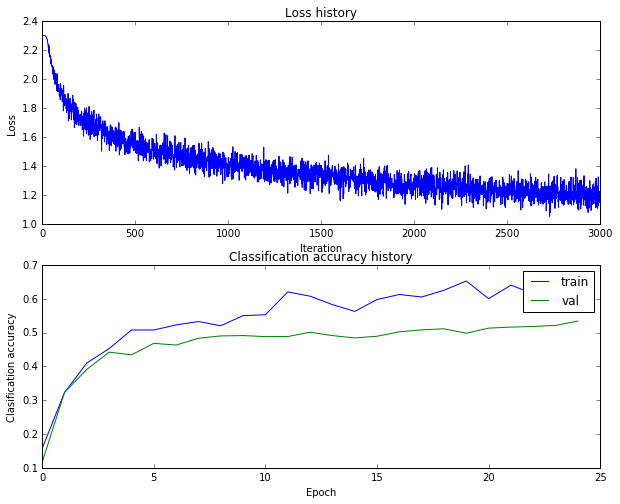

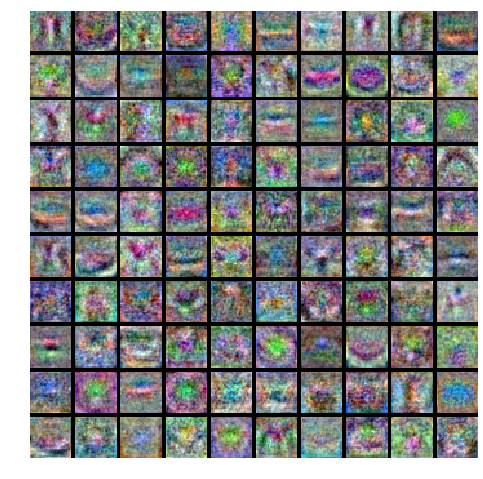

Validation accuracy:  0.529
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 100 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.302766
iteration 100 / 3000: loss 1.862910
iteration 200 / 3000: loss 1.691819
iteration 300 / 3000: loss 1.655695
iteration 400 / 3000: loss 1.650786
iteration 500 / 3000: loss 1.546222
iteration 600 / 3000: loss 1.506553
iteration 700 / 3000: loss 1.526439
iteration 800 / 3000: loss 1.499400
iteration 900 / 3000: loss 1.421031
iteration 1000 / 3000: loss 1.383125
iteration 1100 / 3000: loss 1.397041
iteration 1200 / 3000: loss 1.266671
iteration 1300 / 3000: loss 1.314626
iteration 1400 / 3000: loss 1.371307
iteration 1500 / 3000: loss 1.248781
iteration 1600 / 3000: loss 1.233559
iteration 1700 / 3000: loss 1.245379
iteration 1800 / 3000: loss 1.303113
iteration 1900 / 3000: loss 1.311844
iteration 2000 / 3000: loss 1.270005
iterati

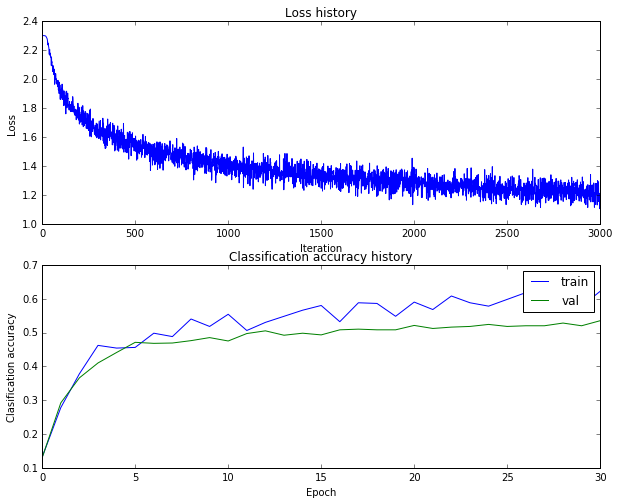

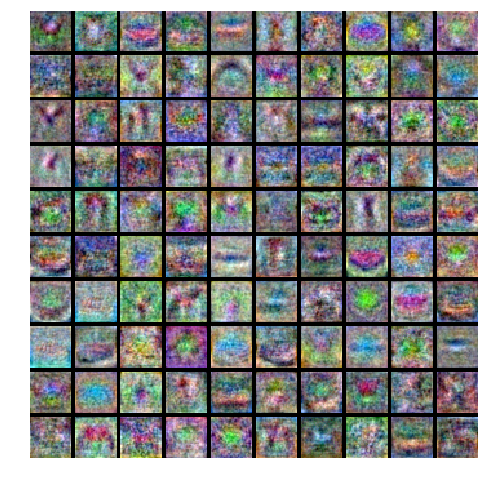

Validation accuracy:  0.522
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 1000
                           and batch size = 50
iteration 0 / 1000: loss 2.302924
iteration 100 / 1000: loss 1.803370
iteration 200 / 1000: loss 1.742667
iteration 300 / 1000: loss 1.946052
iteration 400 / 1000: loss 1.472911
iteration 500 / 1000: loss 1.800171
iteration 600 / 1000: loss 1.638166
iteration 700 / 1000: loss 1.318003
iteration 800 / 1000: loss 1.463939
iteration 900 / 1000: loss 1.522236


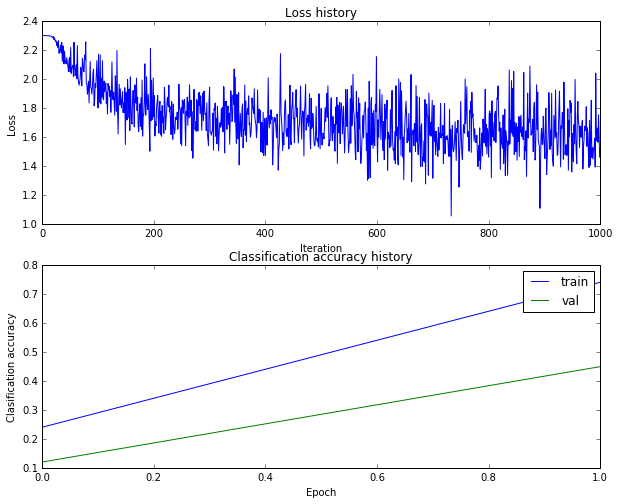

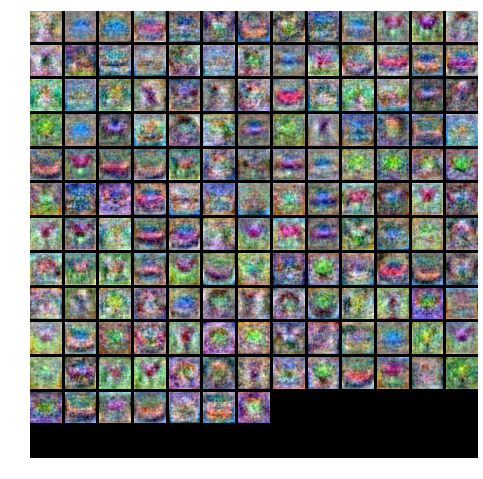

Validation accuracy:  0.416
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 1000
                           and batch size = 100
iteration 0 / 1000: loss 2.302867
iteration 100 / 1000: loss 1.848800
iteration 200 / 1000: loss 1.854659
iteration 300 / 1000: loss 1.624377
iteration 400 / 1000: loss 1.540527
iteration 500 / 1000: loss 1.702661
iteration 600 / 1000: loss 1.816720
iteration 700 / 1000: loss 1.574895
iteration 800 / 1000: loss 1.419227
iteration 900 / 1000: loss 1.553769


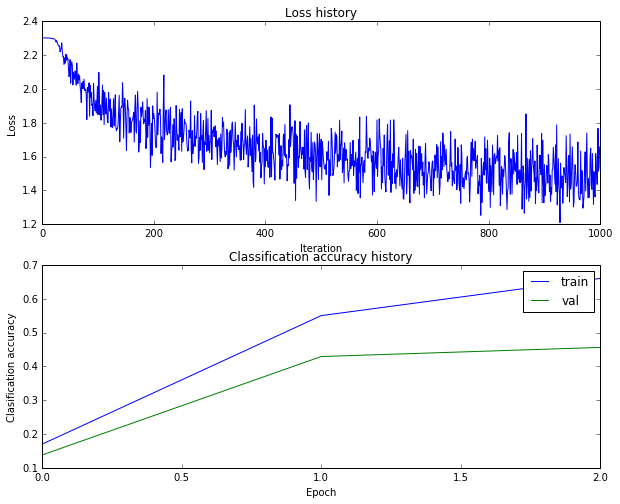

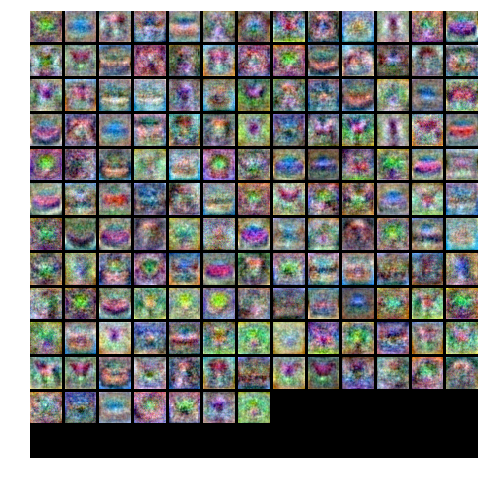

Validation accuracy:  0.475
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 1000
                           and batch size = 200
iteration 0 / 1000: loss 2.302816
iteration 100 / 1000: loss 1.910804
iteration 200 / 1000: loss 1.721473
iteration 300 / 1000: loss 1.687298
iteration 400 / 1000: loss 1.647226
iteration 500 / 1000: loss 1.488617
iteration 600 / 1000: loss 1.382832
iteration 700 / 1000: loss 1.558126
iteration 800 / 1000: loss 1.517855
iteration 900 / 1000: loss 1.379459


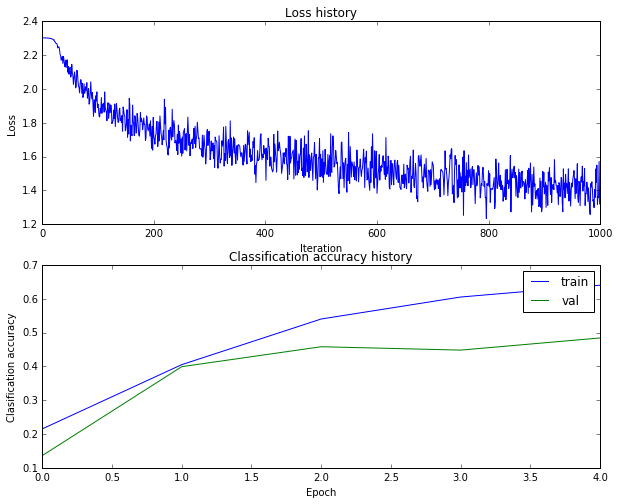

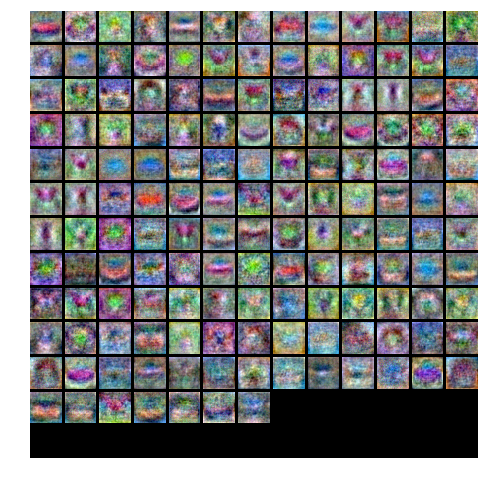

Validation accuracy:  0.505
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 1000
                           and batch size = 300
iteration 0 / 1000: loss 2.302793
iteration 100 / 1000: loss 1.928782
iteration 200 / 1000: loss 1.803432
iteration 300 / 1000: loss 1.684699
iteration 400 / 1000: loss 1.561831
iteration 500 / 1000: loss 1.520677
iteration 600 / 1000: loss 1.503331
iteration 700 / 1000: loss 1.480350
iteration 800 / 1000: loss 1.398041
iteration 900 / 1000: loss 1.314012


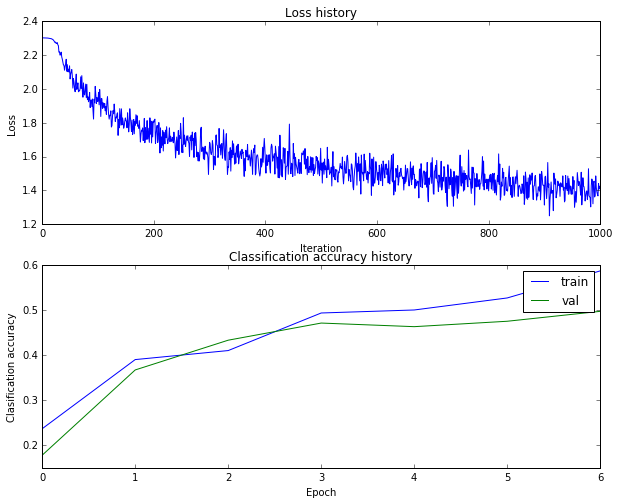

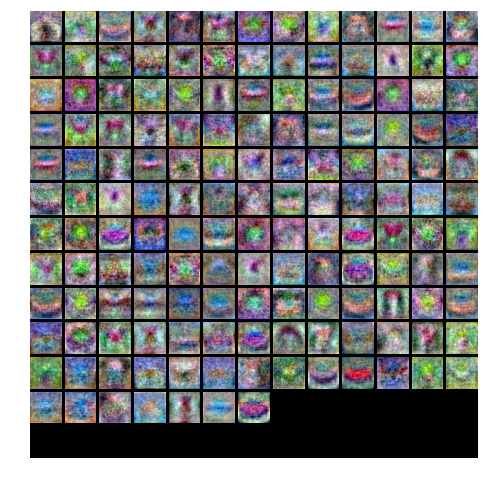

Validation accuracy:  0.503
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 1000
                           and batch size = 400
iteration 0 / 1000: loss 2.302804
iteration 100 / 1000: loss 1.892929
iteration 200 / 1000: loss 1.767669
iteration 300 / 1000: loss 1.615828
iteration 400 / 1000: loss 1.655825
iteration 500 / 1000: loss 1.492268
iteration 600 / 1000: loss 1.476555
iteration 700 / 1000: loss 1.489959
iteration 800 / 1000: loss 1.445992
iteration 900 / 1000: loss 1.451690


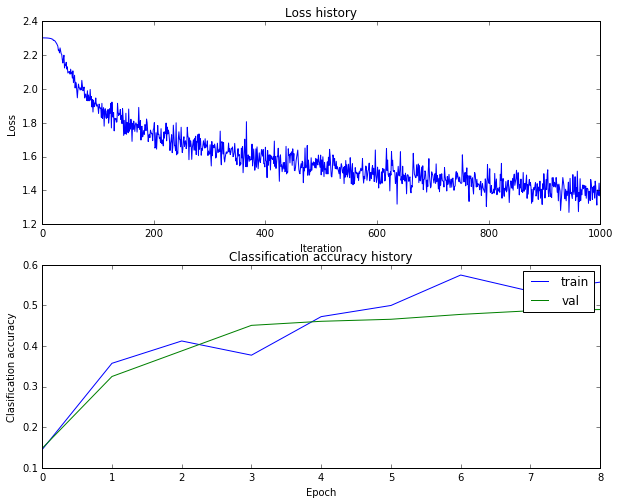

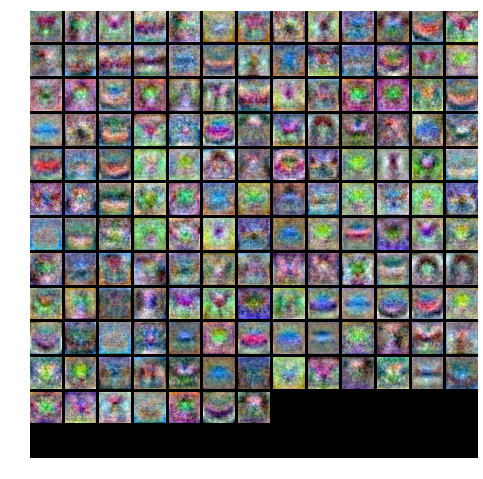

Validation accuracy:  0.477
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 1000
                           and batch size = 500
iteration 0 / 1000: loss 2.302836
iteration 100 / 1000: loss 1.888451
iteration 200 / 1000: loss 1.701275
iteration 300 / 1000: loss 1.608231
iteration 400 / 1000: loss 1.624691
iteration 500 / 1000: loss 1.540477
iteration 600 / 1000: loss 1.480322
iteration 700 / 1000: loss 1.419333
iteration 800 / 1000: loss 1.342318
iteration 900 / 1000: loss 1.520052


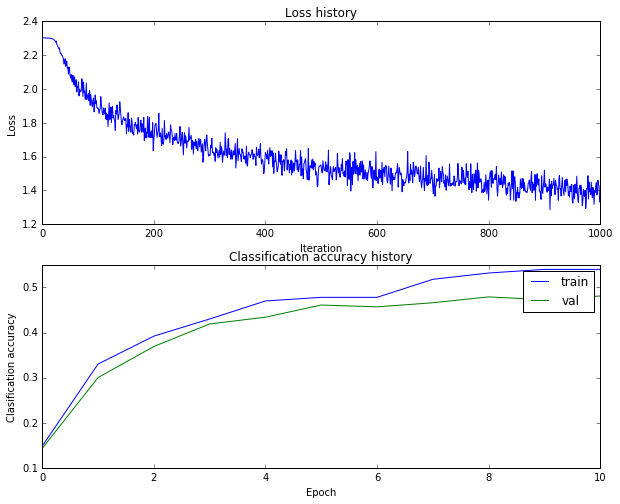

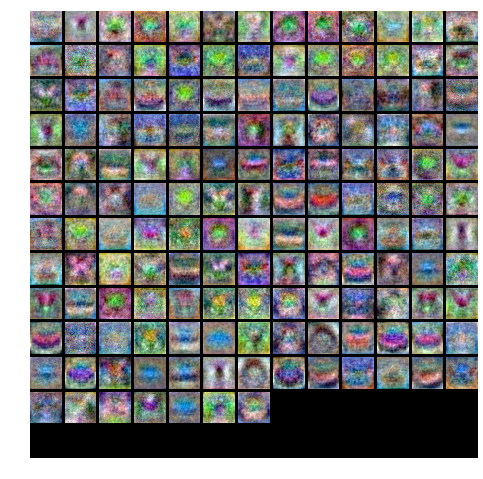

Validation accuracy:  0.49
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 3000
                           and batch size = 50
iteration 0 / 3000: loss 2.302815
iteration 100 / 3000: loss 1.781521
iteration 200 / 3000: loss 1.916462
iteration 300 / 3000: loss 1.616855
iteration 400 / 3000: loss 1.425858
iteration 500 / 3000: loss 1.407787
iteration 600 / 3000: loss 1.745183
iteration 700 / 3000: loss 1.755481
iteration 800 / 3000: loss 1.439091
iteration 900 / 3000: loss 1.676700
iteration 1000 / 3000: loss 1.593371
iteration 1100 / 3000: loss 1.748819
iteration 1200 / 3000: loss 1.653881
iteration 1300 / 3000: loss 1.352273
iteration 1400 / 3000: loss 1.601905
iteration 1500 / 3000: loss 1.527283
iteration 1600 / 3000: loss 1.407680
iteration 1700 / 3000: loss 1.543873
iteration 1800 / 3000: loss 1.169431
iteration 1900 / 3000: loss 1.348231
iteration 2000 / 3000: loss 1.457745
iteration

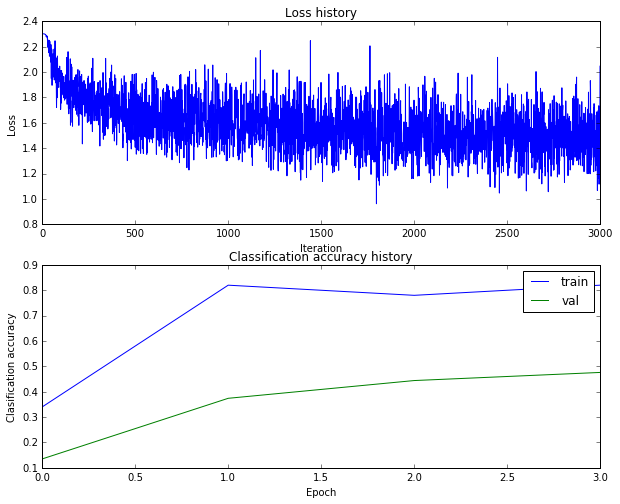

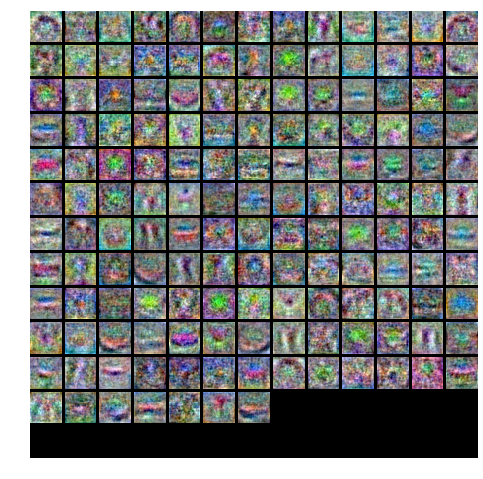

Validation accuracy:  0.421
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 3000
                           and batch size = 100
iteration 0 / 3000: loss 2.302797
iteration 100 / 3000: loss 1.928613
iteration 200 / 3000: loss 1.609986
iteration 300 / 3000: loss 1.792136
iteration 400 / 3000: loss 1.731166
iteration 500 / 3000: loss 1.387487
iteration 600 / 3000: loss 1.398253
iteration 700 / 3000: loss 1.700146
iteration 800 / 3000: loss 1.736550
iteration 900 / 3000: loss 1.681138
iteration 1000 / 3000: loss 1.639595
iteration 1100 / 3000: loss 1.539550
iteration 1200 / 3000: loss 1.448136
iteration 1300 / 3000: loss 1.400703
iteration 1400 / 3000: loss 1.370901
iteration 1500 / 3000: loss 1.344561
iteration 1600 / 3000: loss 1.343685
iteration 1700 / 3000: loss 1.349138
iteration 1800 / 3000: loss 1.460471
iteration 1900 / 3000: loss 1.383973
iteration 2000 / 3000: loss 1.395993
iterati

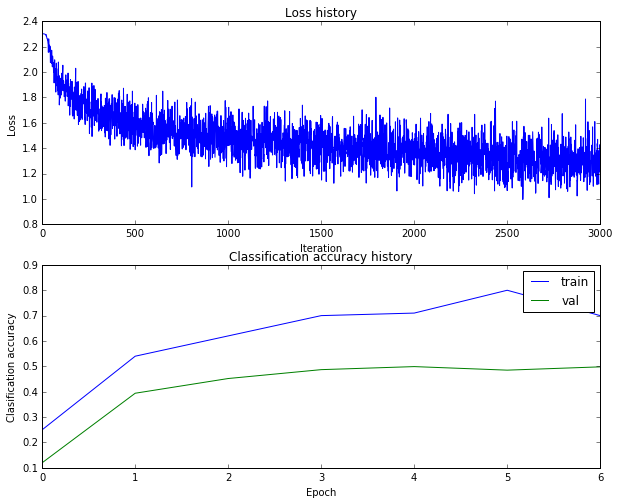

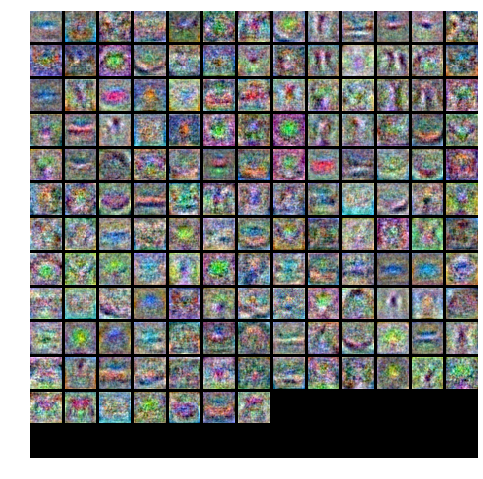

Validation accuracy:  0.519
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.302852
iteration 100 / 3000: loss 1.884186
iteration 200 / 3000: loss 1.759592
iteration 300 / 3000: loss 1.656247
iteration 400 / 3000: loss 1.682842
iteration 500 / 3000: loss 1.547209
iteration 600 / 3000: loss 1.627996
iteration 700 / 3000: loss 1.354153
iteration 800 / 3000: loss 1.446582
iteration 900 / 3000: loss 1.489692
iteration 1000 / 3000: loss 1.421784
iteration 1100 / 3000: loss 1.351774
iteration 1200 / 3000: loss 1.287821
iteration 1300 / 3000: loss 1.326522
iteration 1400 / 3000: loss 1.273267
iteration 1500 / 3000: loss 1.261870
iteration 1600 / 3000: loss 1.349037
iteration 1700 / 3000: loss 1.262897
iteration 1800 / 3000: loss 1.420911
iteration 1900 / 3000: loss 1.182769
iteration 2000 / 3000: loss 1.217678
iterati

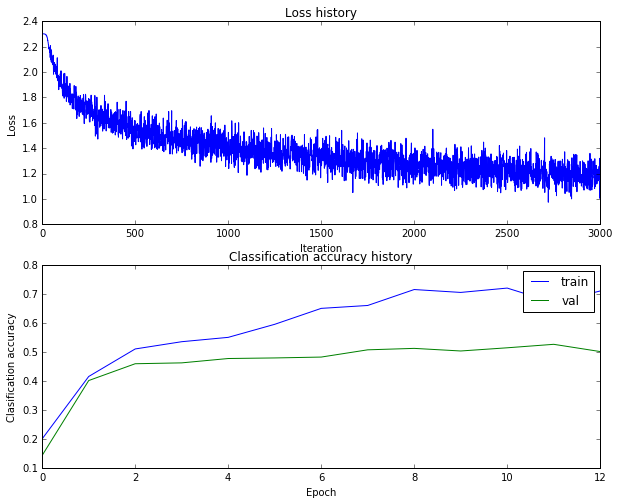

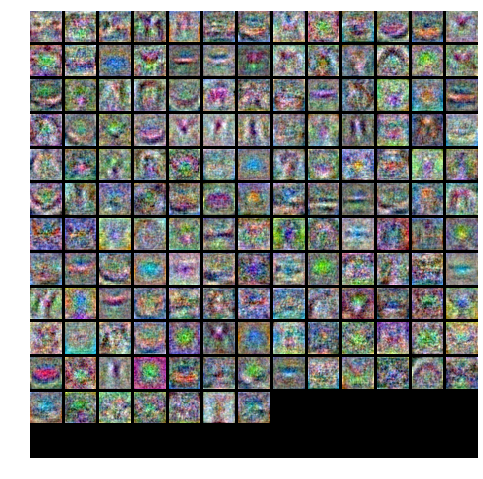

Validation accuracy:  0.539
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.302798
iteration 100 / 3000: loss 2.035759
iteration 200 / 3000: loss 1.639389
iteration 300 / 3000: loss 1.598442
iteration 400 / 3000: loss 1.585495
iteration 500 / 3000: loss 1.615393
iteration 600 / 3000: loss 1.533218
iteration 700 / 3000: loss 1.410223
iteration 800 / 3000: loss 1.579835
iteration 900 / 3000: loss 1.420470
iteration 1000 / 3000: loss 1.407285
iteration 1100 / 3000: loss 1.308408
iteration 1200 / 3000: loss 1.393347
iteration 1300 / 3000: loss 1.452855
iteration 1400 / 3000: loss 1.234935
iteration 1500 / 3000: loss 1.330324
iteration 1600 / 3000: loss 1.214063
iteration 1700 / 3000: loss 1.480904
iteration 1800 / 3000: loss 1.210394
iteration 1900 / 3000: loss 1.220045
iteration 2000 / 3000: loss 1.112492
iterati

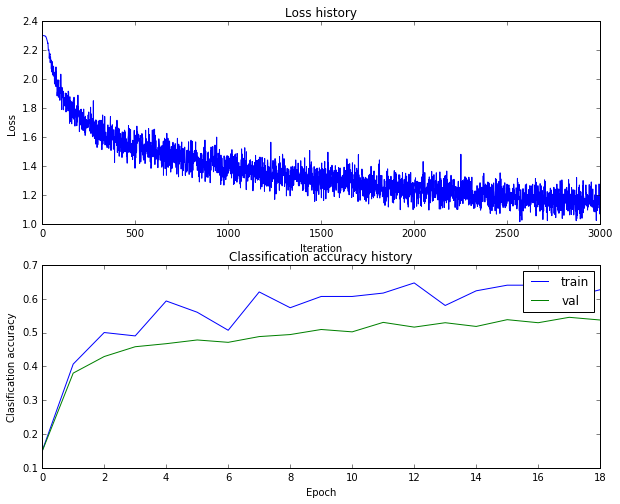

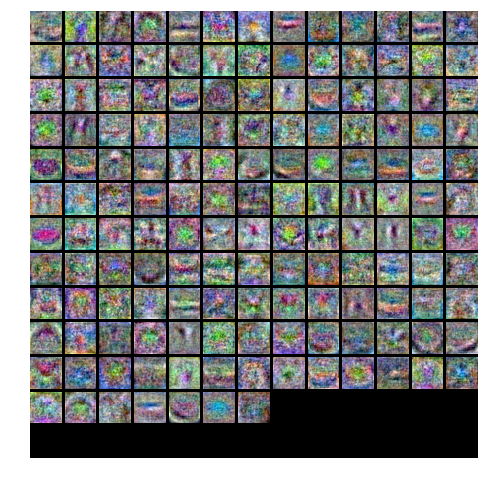

Validation accuracy:  0.54
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.302794
iteration 100 / 3000: loss 1.936587
iteration 200 / 3000: loss 1.835281
iteration 300 / 3000: loss 1.683868
iteration 400 / 3000: loss 1.564701
iteration 500 / 3000: loss 1.512422
iteration 600 / 3000: loss 1.452505
iteration 700 / 3000: loss 1.408434
iteration 800 / 3000: loss 1.414324
iteration 900 / 3000: loss 1.418929
iteration 1000 / 3000: loss 1.393557
iteration 1100 / 3000: loss 1.472027
iteration 1200 / 3000: loss 1.354828
iteration 1300 / 3000: loss 1.314391
iteration 1400 / 3000: loss 1.338091
iteration 1500 / 3000: loss 1.290108
iteration 1600 / 3000: loss 1.297641
iteration 1700 / 3000: loss 1.325979
iteration 1800 / 3000: loss 1.249033
iteration 1900 / 3000: loss 1.161865
iteration 2000 / 3000: loss 1.231398
iteratio

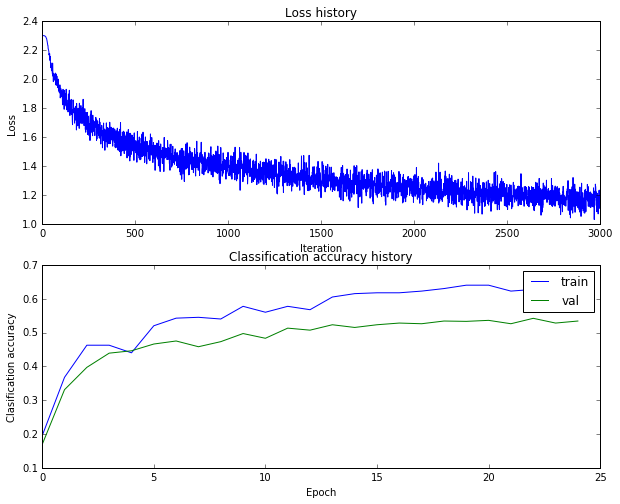

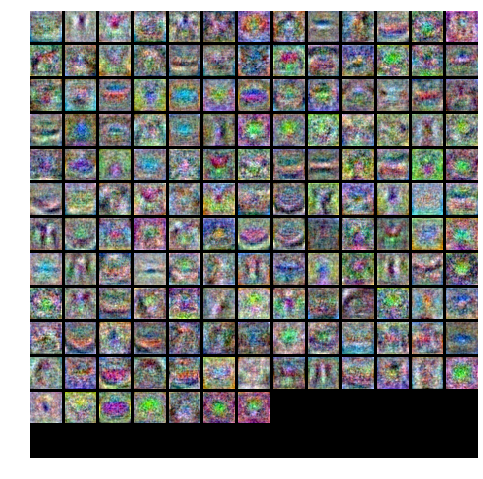

Validation accuracy:  0.534
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 150 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.302820
iteration 100 / 3000: loss 1.912789
iteration 200 / 3000: loss 1.743980
iteration 300 / 3000: loss 1.652479
iteration 400 / 3000: loss 1.650671
iteration 500 / 3000: loss 1.566032
iteration 600 / 3000: loss 1.449869
iteration 700 / 3000: loss 1.438306
iteration 800 / 3000: loss 1.380307
iteration 900 / 3000: loss 1.365106
iteration 1000 / 3000: loss 1.393103
iteration 1100 / 3000: loss 1.296051
iteration 1200 / 3000: loss 1.307517
iteration 1300 / 3000: loss 1.289440
iteration 1400 / 3000: loss 1.295010
iteration 1500 / 3000: loss 1.300782
iteration 1600 / 3000: loss 1.314366
iteration 1700 / 3000: loss 1.300553
iteration 1800 / 3000: loss 1.280695
iteration 1900 / 3000: loss 1.265804
iteration 2000 / 3000: loss 1.271629
iterati

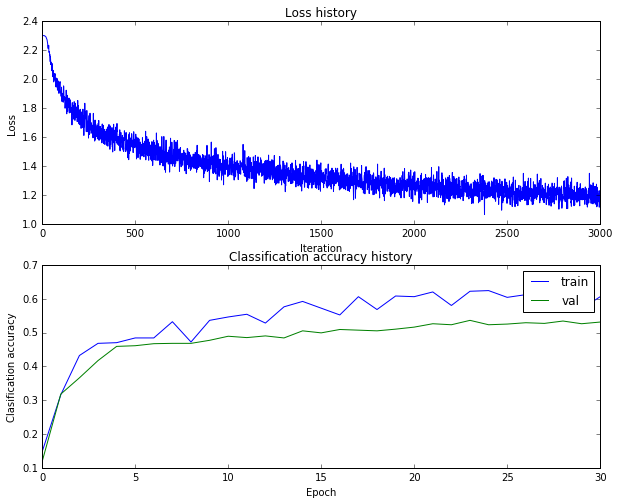

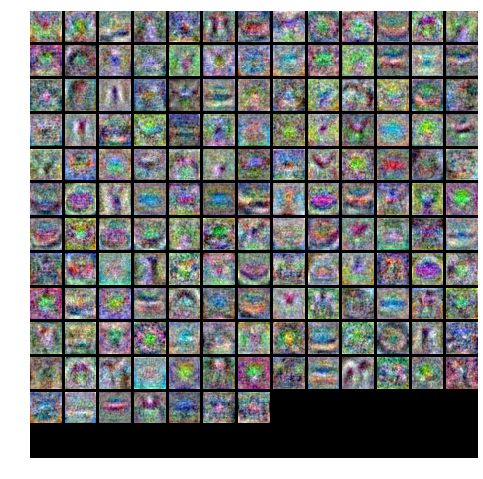

Validation accuracy:  0.541
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 1000
                           and batch size = 50
iteration 0 / 1000: loss 2.302906
iteration 100 / 1000: loss 1.852822
iteration 200 / 1000: loss 1.768447
iteration 300 / 1000: loss 1.653222
iteration 400 / 1000: loss 1.662532
iteration 500 / 1000: loss 1.673607
iteration 600 / 1000: loss 1.662454
iteration 700 / 1000: loss 1.722895
iteration 800 / 1000: loss 1.698547
iteration 900 / 1000: loss 1.585950


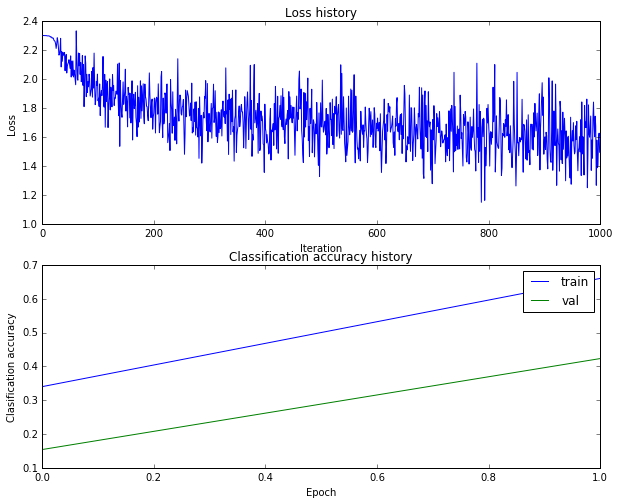

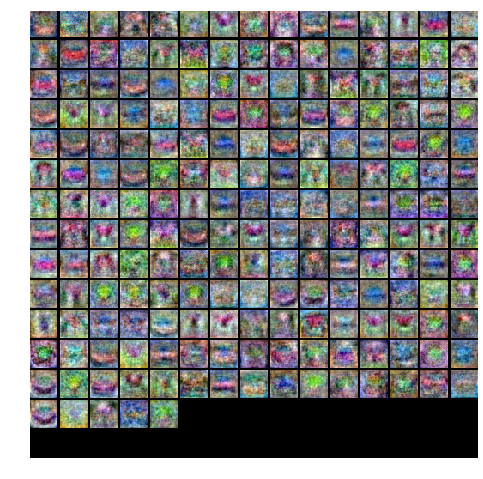

Validation accuracy:  0.442
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 1000
                           and batch size = 100
iteration 0 / 1000: loss 2.302862
iteration 100 / 1000: loss 1.901702
iteration 200 / 1000: loss 1.706982
iteration 300 / 1000: loss 1.701064
iteration 400 / 1000: loss 1.635072
iteration 500 / 1000: loss 1.707055
iteration 600 / 1000: loss 1.818279
iteration 700 / 1000: loss 1.463087
iteration 800 / 1000: loss 1.655505
iteration 900 / 1000: loss 1.488964


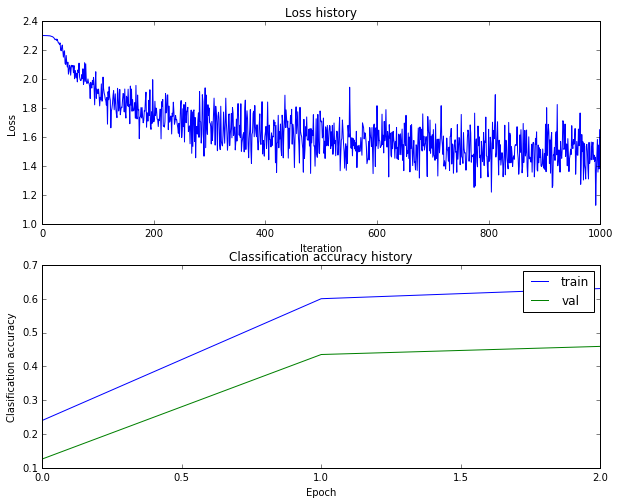

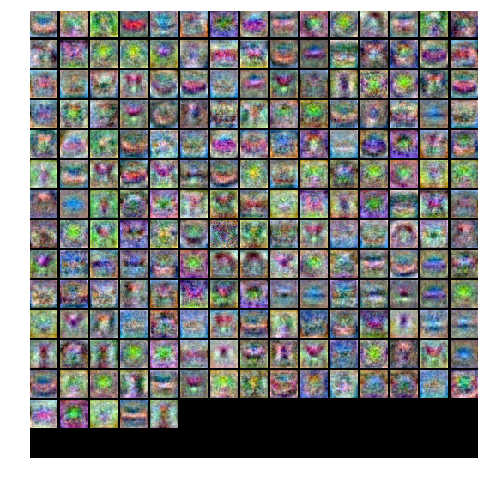

Validation accuracy:  0.487
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 1000
                           and batch size = 200
iteration 0 / 1000: loss 2.302876
iteration 100 / 1000: loss 1.913981
iteration 200 / 1000: loss 1.729011
iteration 300 / 1000: loss 1.615297
iteration 400 / 1000: loss 1.555791
iteration 500 / 1000: loss 1.434685
iteration 600 / 1000: loss 1.429708
iteration 700 / 1000: loss 1.491926
iteration 800 / 1000: loss 1.344796
iteration 900 / 1000: loss 1.336356


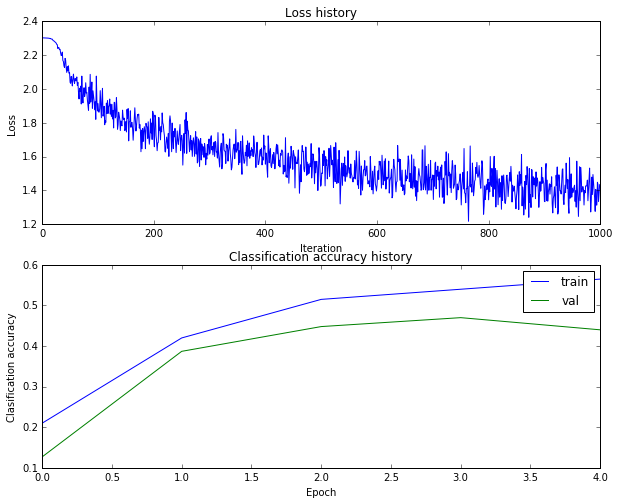

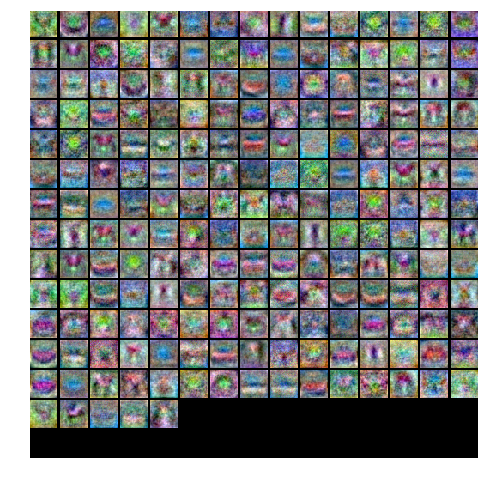

Validation accuracy:  0.487
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 1000
                           and batch size = 300
iteration 0 / 1000: loss 2.302861
iteration 100 / 1000: loss 1.829554
iteration 200 / 1000: loss 1.785232
iteration 300 / 1000: loss 1.741162
iteration 400 / 1000: loss 1.596582
iteration 500 / 1000: loss 1.519470
iteration 600 / 1000: loss 1.543885
iteration 700 / 1000: loss 1.456848
iteration 800 / 1000: loss 1.441815
iteration 900 / 1000: loss 1.454413


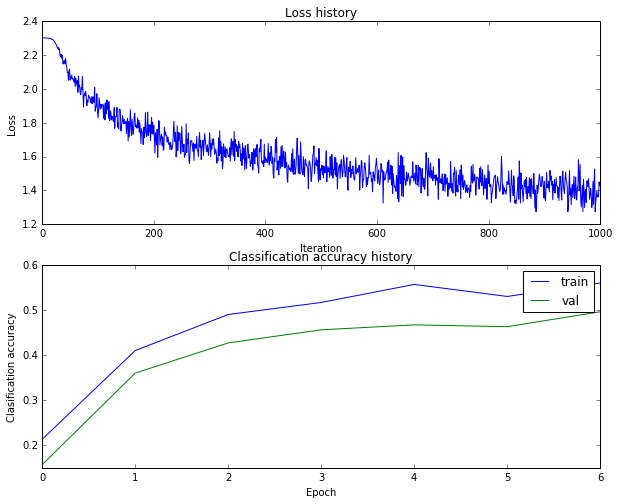

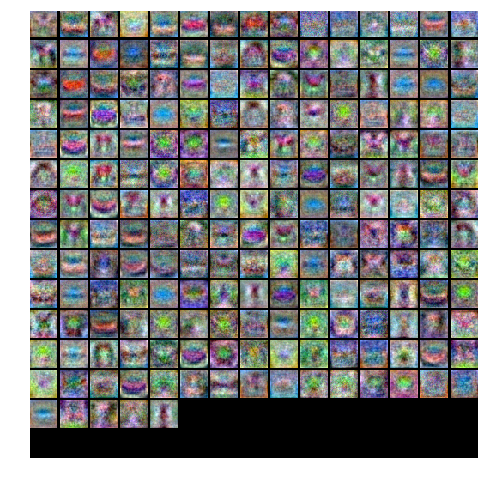

Validation accuracy:  0.509
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 1000
                           and batch size = 400
iteration 0 / 1000: loss 2.302921
iteration 100 / 1000: loss 1.880336
iteration 200 / 1000: loss 1.672139
iteration 300 / 1000: loss 1.648019
iteration 400 / 1000: loss 1.630958
iteration 500 / 1000: loss 1.585951
iteration 600 / 1000: loss 1.447576
iteration 700 / 1000: loss 1.544295
iteration 800 / 1000: loss 1.435084
iteration 900 / 1000: loss 1.353913


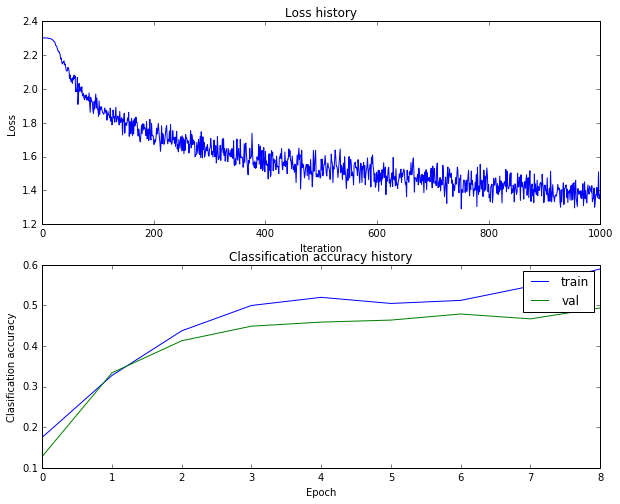

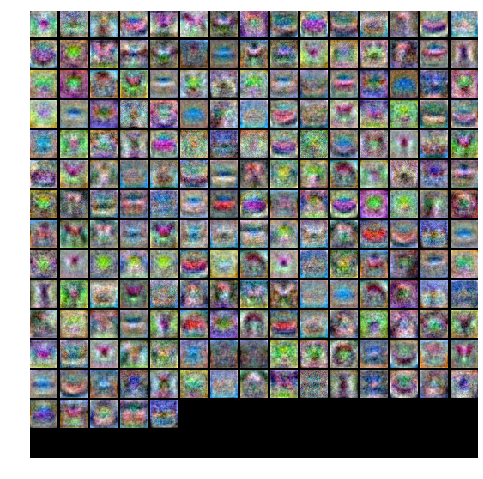

Validation accuracy:  0.483
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 1000
                           and batch size = 500
iteration 0 / 1000: loss 2.302879
iteration 100 / 1000: loss 1.877011
iteration 200 / 1000: loss 1.728405
iteration 300 / 1000: loss 1.665821
iteration 400 / 1000: loss 1.546889
iteration 500 / 1000: loss 1.536893
iteration 600 / 1000: loss 1.490435
iteration 700 / 1000: loss 1.482196
iteration 800 / 1000: loss 1.420408
iteration 900 / 1000: loss 1.432472


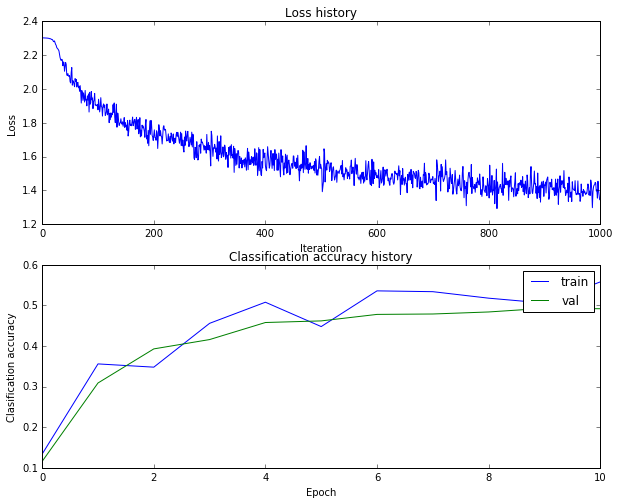

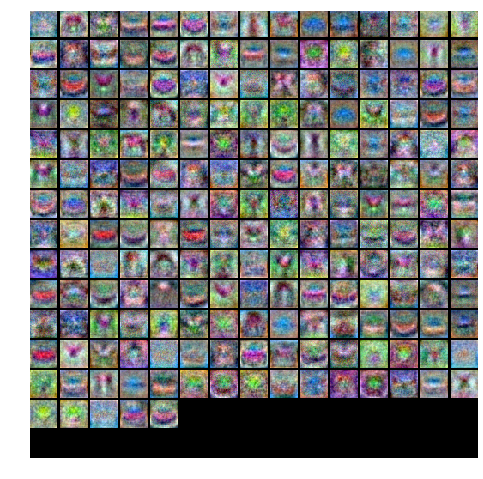

Validation accuracy:  0.502
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 3000
                           and batch size = 50
iteration 0 / 3000: loss 2.302873
iteration 100 / 3000: loss 2.032571
iteration 200 / 3000: loss 1.828778
iteration 300 / 3000: loss 1.768882
iteration 400 / 3000: loss 1.585268
iteration 500 / 3000: loss 1.426991
iteration 600 / 3000: loss 1.902925
iteration 700 / 3000: loss 1.682531
iteration 800 / 3000: loss 1.851697
iteration 900 / 3000: loss 1.706408
iteration 1000 / 3000: loss 1.413267
iteration 1100 / 3000: loss 1.966478
iteration 1200 / 3000: loss 1.753492
iteration 1300 / 3000: loss 1.306148
iteration 1400 / 3000: loss 1.396200
iteration 1500 / 3000: loss 1.636856
iteration 1600 / 3000: loss 1.484479
iteration 1700 / 3000: loss 1.607254
iteration 1800 / 3000: loss 1.474065
iteration 1900 / 3000: loss 1.573298
iteration 2000 / 3000: loss 1.789066
iteratio

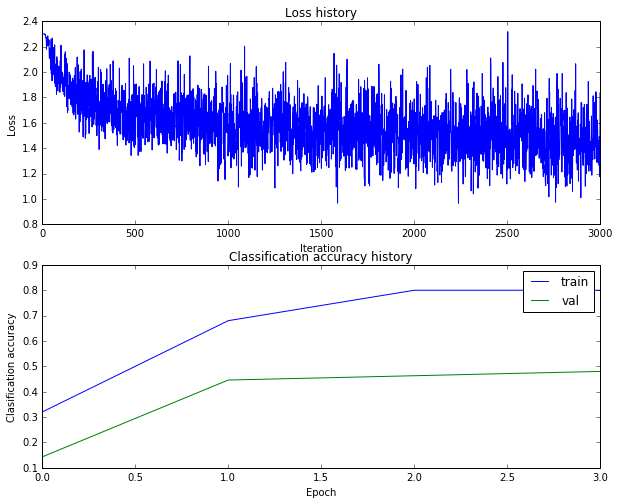

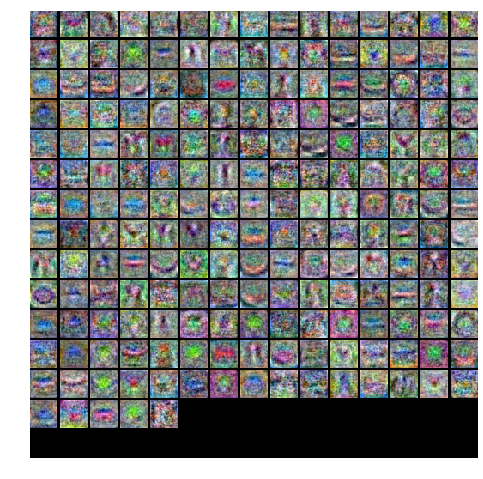

Validation accuracy:  0.468
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 3000
                           and batch size = 100
iteration 0 / 3000: loss 2.302913
iteration 100 / 3000: loss 1.961703
iteration 200 / 3000: loss 1.870285
iteration 300 / 3000: loss 1.792422
iteration 400 / 3000: loss 1.525714
iteration 500 / 3000: loss 1.473755
iteration 600 / 3000: loss 1.429013
iteration 700 / 3000: loss 1.524709
iteration 800 / 3000: loss 1.415783
iteration 900 / 3000: loss 1.563409
iteration 1000 / 3000: loss 1.892130
iteration 1100 / 3000: loss 1.407078
iteration 1200 / 3000: loss 1.358615
iteration 1300 / 3000: loss 1.304673
iteration 1400 / 3000: loss 1.495397
iteration 1500 / 3000: loss 1.330441
iteration 1600 / 3000: loss 1.418255
iteration 1700 / 3000: loss 1.467839
iteration 1800 / 3000: loss 1.284260
iteration 1900 / 3000: loss 1.423355
iteration 2000 / 3000: loss 1.389212
iterati

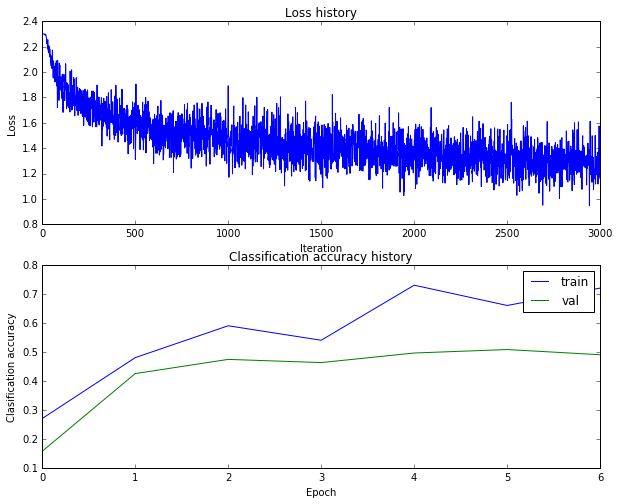

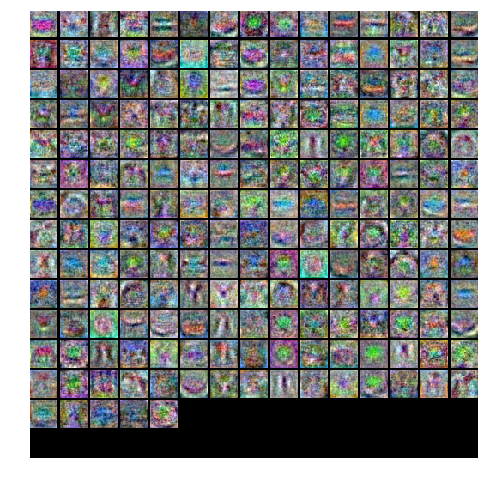

Validation accuracy:  0.482
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.302883
iteration 100 / 3000: loss 1.949841
iteration 200 / 3000: loss 1.791747
iteration 300 / 3000: loss 1.654425
iteration 400 / 3000: loss 1.643285
iteration 500 / 3000: loss 1.534452
iteration 600 / 3000: loss 1.432568
iteration 700 / 3000: loss 1.397245
iteration 800 / 3000: loss 1.465765
iteration 900 / 3000: loss 1.369412
iteration 1000 / 3000: loss 1.408824
iteration 1100 / 3000: loss 1.351698
iteration 1200 / 3000: loss 1.284165
iteration 1300 / 3000: loss 1.381674
iteration 1400 / 3000: loss 1.395936
iteration 1500 / 3000: loss 1.352999
iteration 1600 / 3000: loss 1.280204
iteration 1700 / 3000: loss 1.178474
iteration 1800 / 3000: loss 1.235025
iteration 1900 / 3000: loss 1.302904
iteration 2000 / 3000: loss 1.227142
iterati

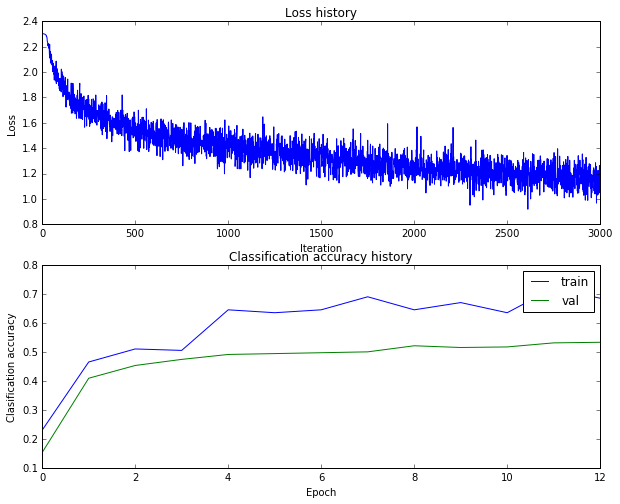

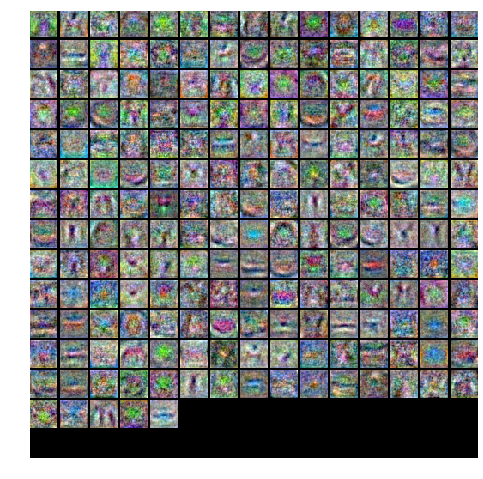

Validation accuracy:  0.543
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.302870
iteration 100 / 3000: loss 1.889295
iteration 200 / 3000: loss 1.717321
iteration 300 / 3000: loss 1.725839
iteration 400 / 3000: loss 1.621738
iteration 500 / 3000: loss 1.472146
iteration 600 / 3000: loss 1.485306
iteration 700 / 3000: loss 1.400254
iteration 800 / 3000: loss 1.400116
iteration 900 / 3000: loss 1.427875
iteration 1000 / 3000: loss 1.447834
iteration 1100 / 3000: loss 1.416356
iteration 1200 / 3000: loss 1.268608
iteration 1300 / 3000: loss 1.314356
iteration 1400 / 3000: loss 1.427132
iteration 1500 / 3000: loss 1.231231
iteration 1600 / 3000: loss 1.286980
iteration 1700 / 3000: loss 1.187610
iteration 1800 / 3000: loss 1.250565
iteration 1900 / 3000: loss 1.303026
iteration 2000 / 3000: loss 1.174943
iterati

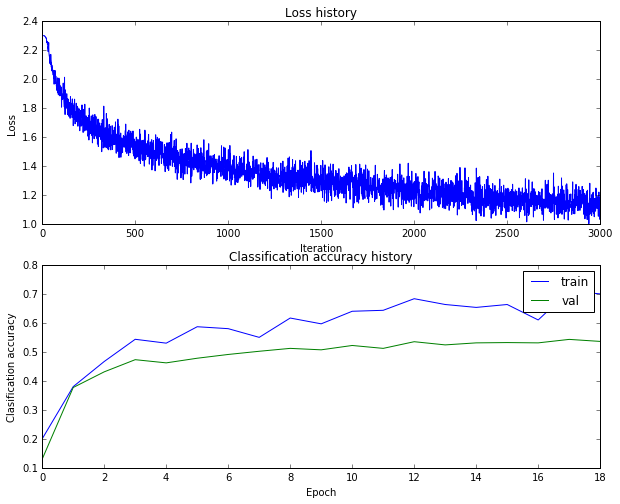

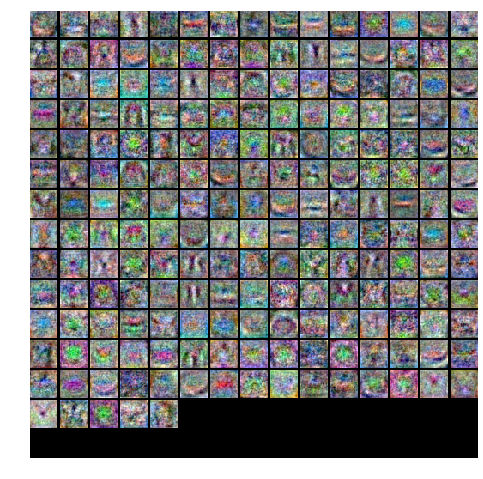

Validation accuracy:  0.542
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.302855
iteration 100 / 3000: loss 1.917456
iteration 200 / 3000: loss 1.780188
iteration 300 / 3000: loss 1.633758
iteration 400 / 3000: loss 1.608513
iteration 500 / 3000: loss 1.598174
iteration 600 / 3000: loss 1.514956
iteration 700 / 3000: loss 1.500751
iteration 800 / 3000: loss 1.473370
iteration 900 / 3000: loss 1.386051
iteration 1000 / 3000: loss 1.506014
iteration 1100 / 3000: loss 1.347136
iteration 1200 / 3000: loss 1.259923
iteration 1300 / 3000: loss 1.344856
iteration 1400 / 3000: loss 1.302848
iteration 1500 / 3000: loss 1.258811
iteration 1600 / 3000: loss 1.202771
iteration 1700 / 3000: loss 1.319557
iteration 1800 / 3000: loss 1.267004
iteration 1900 / 3000: loss 1.380159
iteration 2000 / 3000: loss 1.259595
iterati

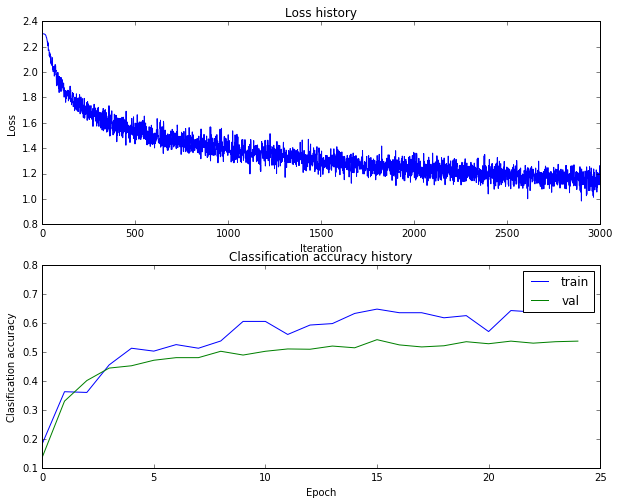

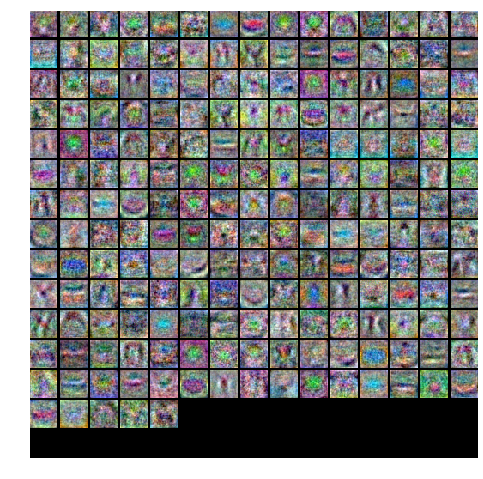

Validation accuracy:  0.533
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 200 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.302852
iteration 100 / 3000: loss 1.879992
iteration 200 / 3000: loss 1.747895
iteration 300 / 3000: loss 1.674498
iteration 400 / 3000: loss 1.582066
iteration 500 / 3000: loss 1.470552
iteration 600 / 3000: loss 1.378506
iteration 700 / 3000: loss 1.474828
iteration 800 / 3000: loss 1.480633
iteration 900 / 3000: loss 1.460206
iteration 1000 / 3000: loss 1.423863
iteration 1100 / 3000: loss 1.421359
iteration 1200 / 3000: loss 1.363100
iteration 1300 / 3000: loss 1.398137
iteration 1400 / 3000: loss 1.373728
iteration 1500 / 3000: loss 1.389513
iteration 1600 / 3000: loss 1.295655
iteration 1700 / 3000: loss 1.242627
iteration 1800 / 3000: loss 1.297000
iteration 1900 / 3000: loss 1.266572
iteration 2000 / 3000: loss 1.184584
iterati

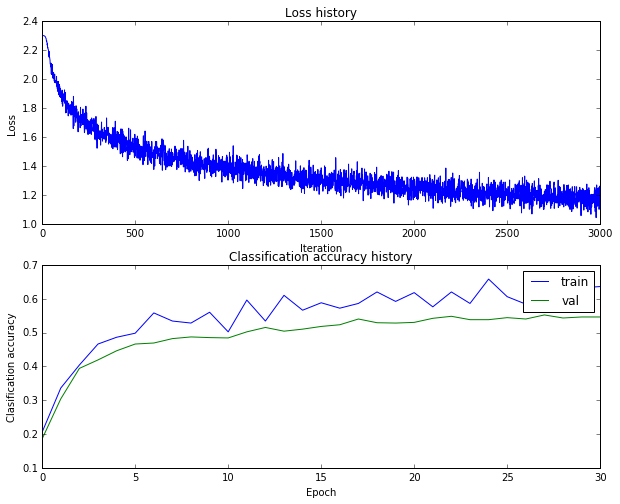

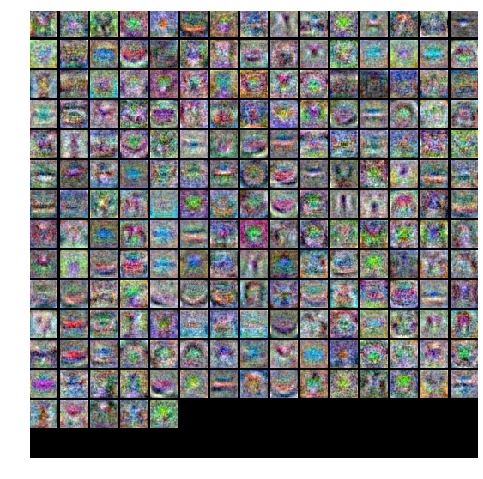

Validation accuracy:  0.546
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 1000
                           and batch size = 50
iteration 0 / 1000: loss 2.302940
iteration 100 / 1000: loss 1.945777
iteration 200 / 1000: loss 1.634086
iteration 300 / 1000: loss 1.678304
iteration 400 / 1000: loss 1.709853
iteration 500 / 1000: loss 1.673262
iteration 600 / 1000: loss 1.754085
iteration 700 / 1000: loss 1.447681
iteration 800 / 1000: loss 1.690310
iteration 900 / 1000: loss 1.691270


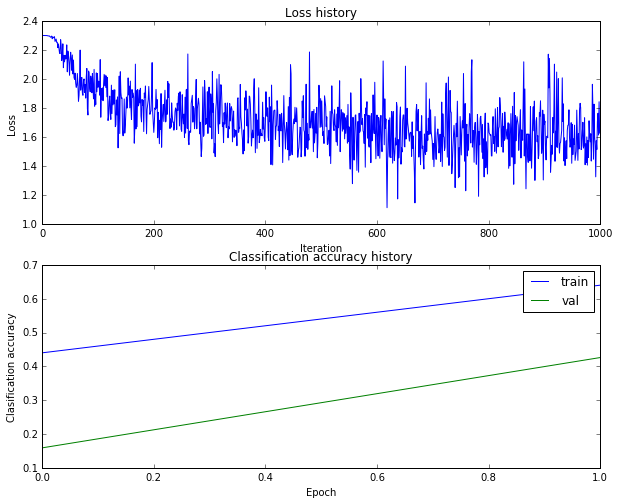

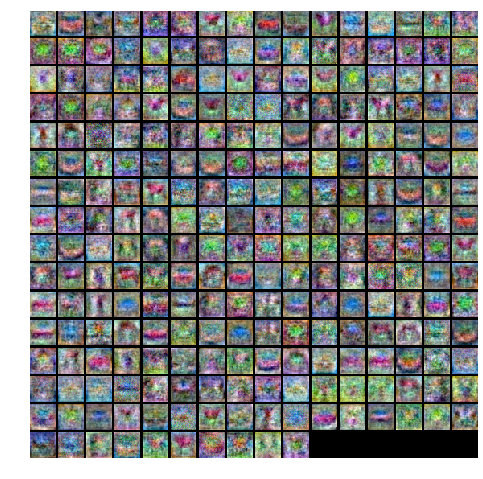

Validation accuracy:  0.442
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 1000
                           and batch size = 100
iteration 0 / 1000: loss 2.303005
iteration 100 / 1000: loss 1.838571
iteration 200 / 1000: loss 1.722838
iteration 300 / 1000: loss 1.519809
iteration 400 / 1000: loss 1.696410
iteration 500 / 1000: loss 1.652174
iteration 600 / 1000: loss 1.410906
iteration 700 / 1000: loss 1.626612
iteration 800 / 1000: loss 1.443173
iteration 900 / 1000: loss 1.472054


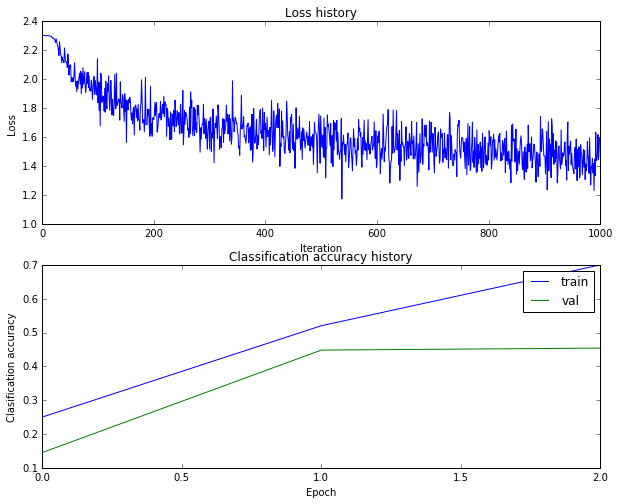

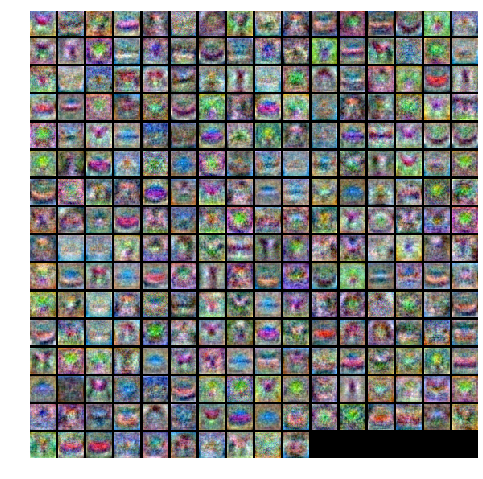

Validation accuracy:  0.462
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 1000
                           and batch size = 200
iteration 0 / 1000: loss 2.302999
iteration 100 / 1000: loss 1.909237
iteration 200 / 1000: loss 1.806476
iteration 300 / 1000: loss 1.772329
iteration 400 / 1000: loss 1.659631
iteration 500 / 1000: loss 1.595339
iteration 600 / 1000: loss 1.638712
iteration 700 / 1000: loss 1.459533
iteration 800 / 1000: loss 1.452621
iteration 900 / 1000: loss 1.520587


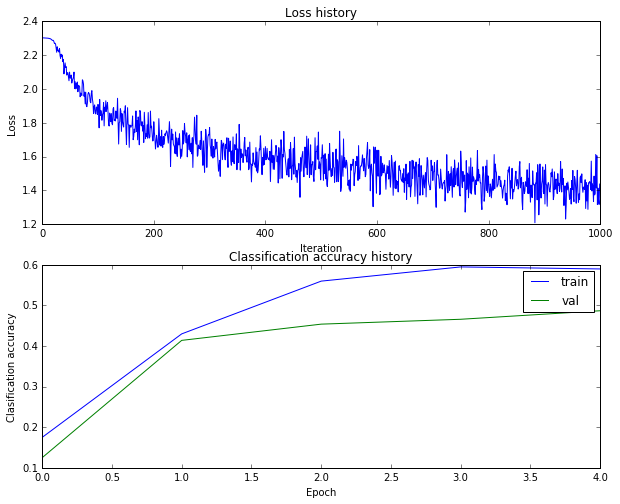

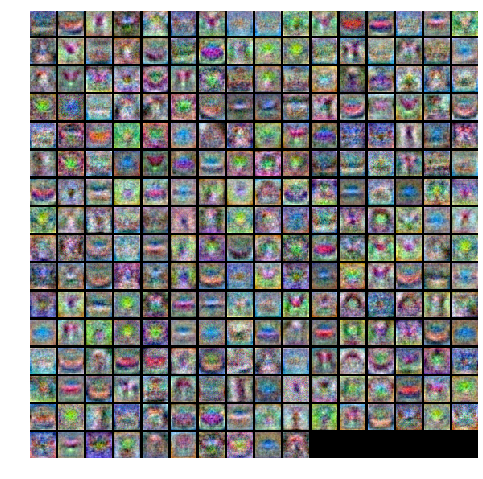

Validation accuracy:  0.493
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 1000
                           and batch size = 300
iteration 0 / 1000: loss 2.302948
iteration 100 / 1000: loss 1.928523
iteration 200 / 1000: loss 1.758507
iteration 300 / 1000: loss 1.638631
iteration 400 / 1000: loss 1.657775
iteration 500 / 1000: loss 1.550790
iteration 600 / 1000: loss 1.601412
iteration 700 / 1000: loss 1.465326
iteration 800 / 1000: loss 1.459422
iteration 900 / 1000: loss 1.365808


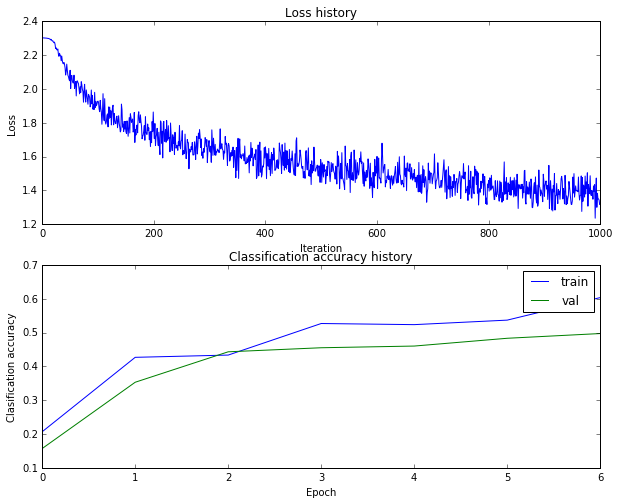

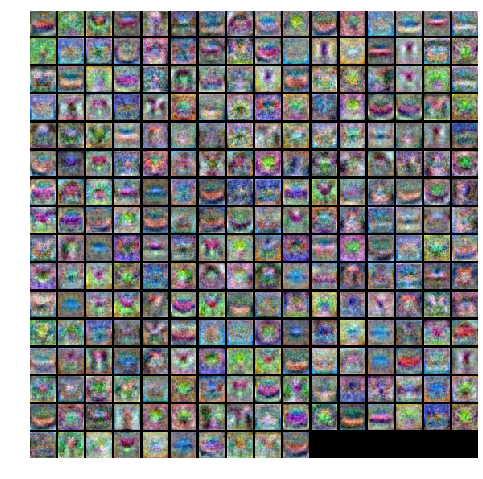

Validation accuracy:  0.494
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 1000
                           and batch size = 400
iteration 0 / 1000: loss 2.302973
iteration 100 / 1000: loss 1.870515
iteration 200 / 1000: loss 1.804522
iteration 300 / 1000: loss 1.588636
iteration 400 / 1000: loss 1.462788
iteration 500 / 1000: loss 1.596627
iteration 600 / 1000: loss 1.531157
iteration 700 / 1000: loss 1.380848
iteration 800 / 1000: loss 1.409785
iteration 900 / 1000: loss 1.463776


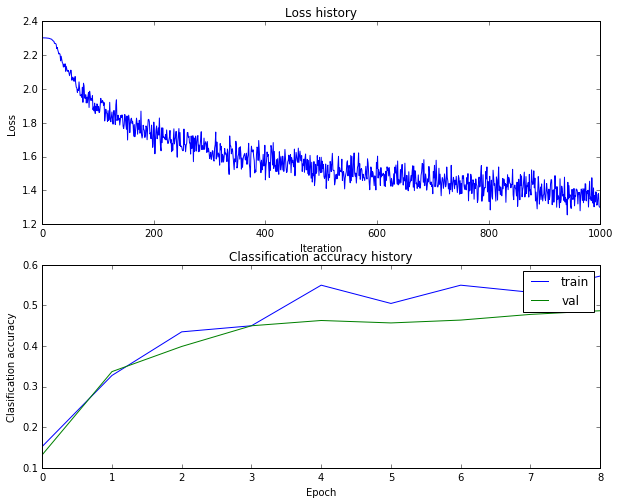

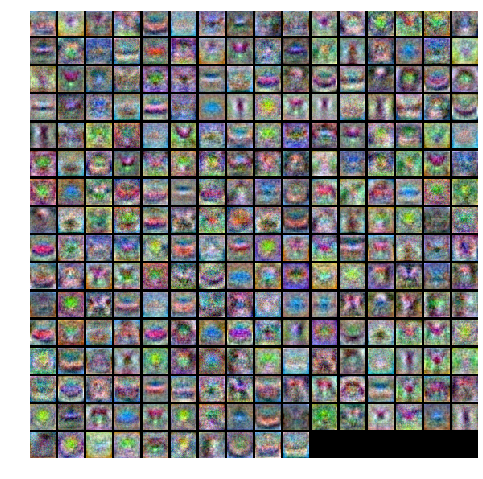

Validation accuracy:  0.492
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 1000
                           and batch size = 500
iteration 0 / 1000: loss 2.302970
iteration 100 / 1000: loss 1.874739
iteration 200 / 1000: loss 1.764236
iteration 300 / 1000: loss 1.685939
iteration 400 / 1000: loss 1.564253
iteration 500 / 1000: loss 1.507096
iteration 600 / 1000: loss 1.539481
iteration 700 / 1000: loss 1.475052
iteration 800 / 1000: loss 1.455783
iteration 900 / 1000: loss 1.381370


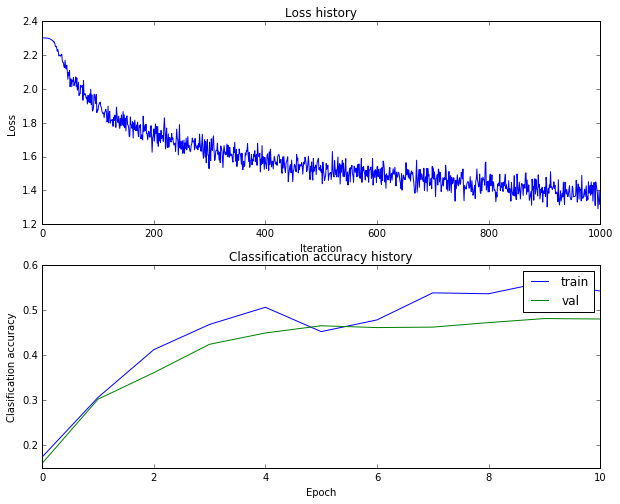

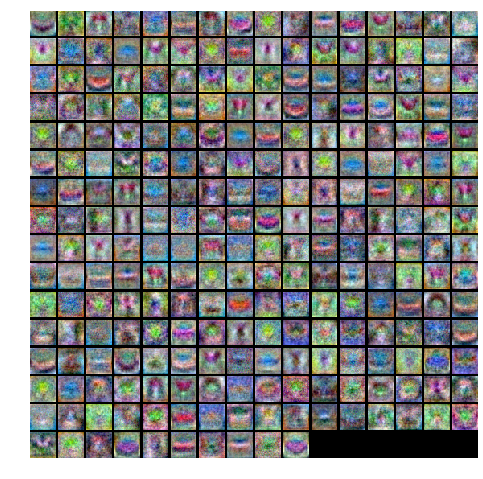

Validation accuracy:  0.488
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 3000
                           and batch size = 50
iteration 0 / 3000: loss 2.303016
iteration 100 / 3000: loss 1.802897
iteration 200 / 3000: loss 1.903415
iteration 300 / 3000: loss 1.355948
iteration 400 / 3000: loss 1.819982
iteration 500 / 3000: loss 1.778843
iteration 600 / 3000: loss 1.619412
iteration 700 / 3000: loss 1.887059
iteration 800 / 3000: loss 1.817580
iteration 900 / 3000: loss 1.594047
iteration 1000 / 3000: loss 1.815358
iteration 1100 / 3000: loss 1.623905
iteration 1200 / 3000: loss 1.588846
iteration 1300 / 3000: loss 1.455176
iteration 1400 / 3000: loss 1.589662
iteration 1500 / 3000: loss 1.965438
iteration 1600 / 3000: loss 1.688960
iteration 1700 / 3000: loss 1.671051
iteration 1800 / 3000: loss 1.439851
iteration 1900 / 3000: loss 1.586213
iteration 2000 / 3000: loss 1.647251
iteratio

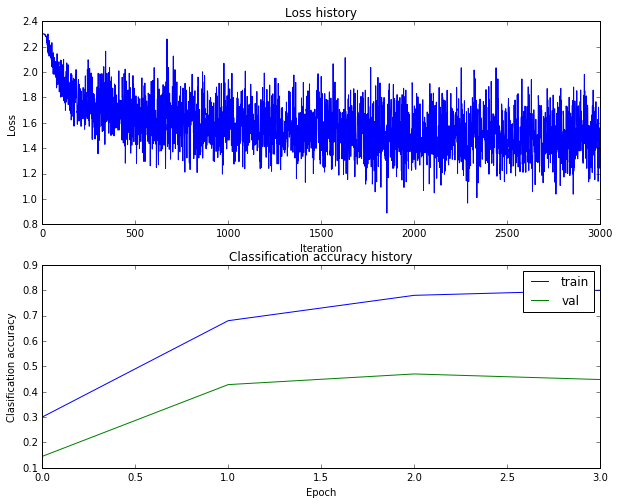

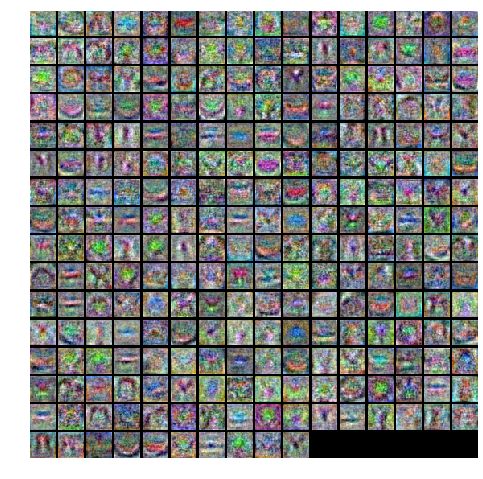

Validation accuracy:  0.47
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 3000
                           and batch size = 100
iteration 0 / 3000: loss 2.302958
iteration 100 / 3000: loss 1.911962
iteration 200 / 3000: loss 1.647329
iteration 300 / 3000: loss 1.744438
iteration 400 / 3000: loss 1.709328
iteration 500 / 3000: loss 1.681349
iteration 600 / 3000: loss 1.410207
iteration 700 / 3000: loss 1.583374
iteration 800 / 3000: loss 1.431996
iteration 900 / 3000: loss 1.502683
iteration 1000 / 3000: loss 1.576436
iteration 1100 / 3000: loss 1.299519
iteration 1200 / 3000: loss 1.487570
iteration 1300 / 3000: loss 1.412774
iteration 1400 / 3000: loss 1.656621
iteration 1500 / 3000: loss 1.344859
iteration 1600 / 3000: loss 1.494170
iteration 1700 / 3000: loss 1.419578
iteration 1800 / 3000: loss 1.297657
iteration 1900 / 3000: loss 1.446039
iteration 2000 / 3000: loss 1.254160
iteratio

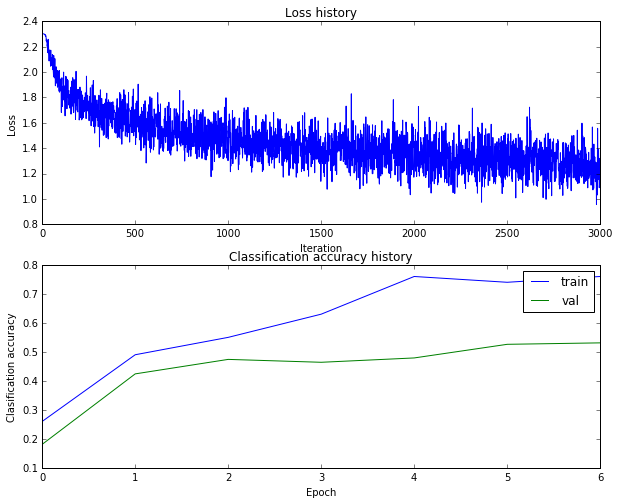

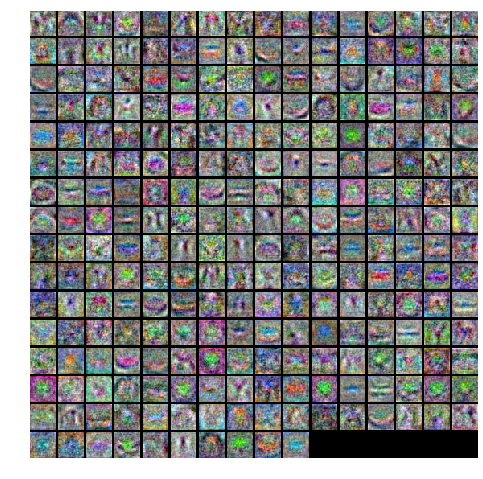

Validation accuracy:  0.499
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.302961
iteration 100 / 3000: loss 1.944129
iteration 200 / 3000: loss 1.756125
iteration 300 / 3000: loss 1.630783
iteration 400 / 3000: loss 1.520093
iteration 500 / 3000: loss 1.536154
iteration 600 / 3000: loss 1.469136
iteration 700 / 3000: loss 1.480264
iteration 800 / 3000: loss 1.482058
iteration 900 / 3000: loss 1.551724
iteration 1000 / 3000: loss 1.319965
iteration 1100 / 3000: loss 1.396918
iteration 1200 / 3000: loss 1.329103
iteration 1300 / 3000: loss 1.267376
iteration 1400 / 3000: loss 1.274022
iteration 1500 / 3000: loss 1.327447
iteration 1600 / 3000: loss 1.305392
iteration 1700 / 3000: loss 1.229063
iteration 1800 / 3000: loss 1.295445
iteration 1900 / 3000: loss 1.254260
iteration 2000 / 3000: loss 1.251513
iterati

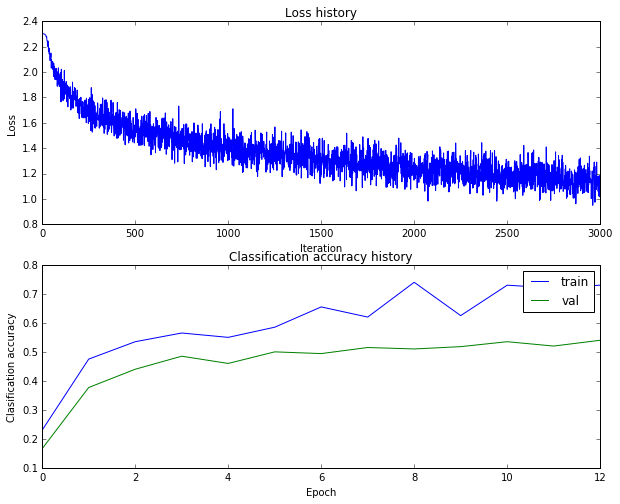

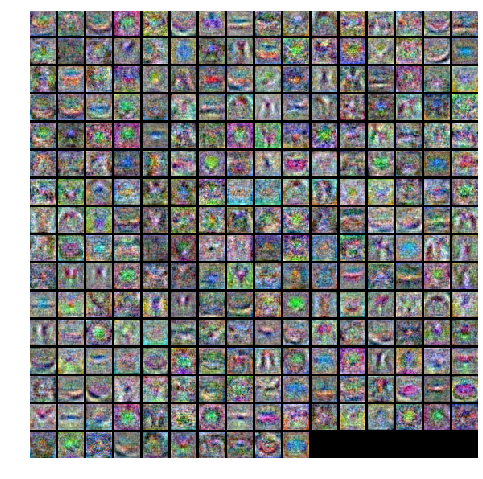

Validation accuracy:  0.535
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.303002
iteration 100 / 3000: loss 1.930766
iteration 200 / 3000: loss 1.744961
iteration 300 / 3000: loss 1.642134
iteration 400 / 3000: loss 1.656912
iteration 500 / 3000: loss 1.532907
iteration 600 / 3000: loss 1.492373
iteration 700 / 3000: loss 1.455502
iteration 800 / 3000: loss 1.394740
iteration 900 / 3000: loss 1.414527
iteration 1000 / 3000: loss 1.369588
iteration 1100 / 3000: loss 1.284304
iteration 1200 / 3000: loss 1.266443
iteration 1300 / 3000: loss 1.237200
iteration 1400 / 3000: loss 1.334307
iteration 1500 / 3000: loss 1.399726
iteration 1600 / 3000: loss 1.237839
iteration 1700 / 3000: loss 1.287769
iteration 1800 / 3000: loss 1.235253
iteration 1900 / 3000: loss 1.230912
iteration 2000 / 3000: loss 1.251255
iterati

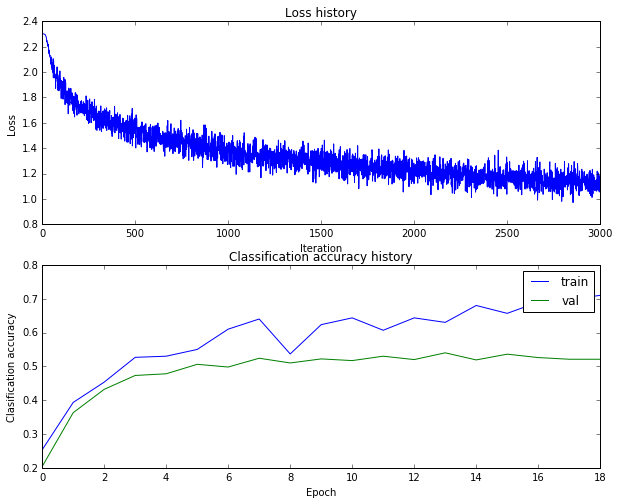

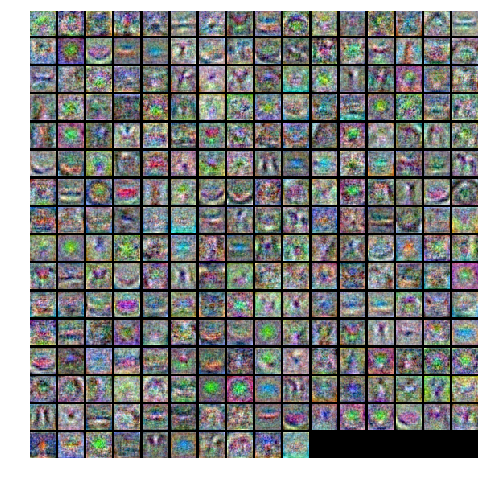

Validation accuracy:  0.533
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.302959
iteration 100 / 3000: loss 1.903219
iteration 200 / 3000: loss 1.789796
iteration 300 / 3000: loss 1.577565
iteration 400 / 3000: loss 1.547078
iteration 500 / 3000: loss 1.531148
iteration 600 / 3000: loss 1.463037
iteration 700 / 3000: loss 1.412605
iteration 800 / 3000: loss 1.442077
iteration 900 / 3000: loss 1.389458
iteration 1000 / 3000: loss 1.384696
iteration 1100 / 3000: loss 1.303133
iteration 1200 / 3000: loss 1.294335
iteration 1300 / 3000: loss 1.427700
iteration 1400 / 3000: loss 1.309494
iteration 1500 / 3000: loss 1.329288
iteration 1600 / 3000: loss 1.296830
iteration 1700 / 3000: loss 1.262031
iteration 1800 / 3000: loss 1.254337
iteration 1900 / 3000: loss 1.245887
iteration 2000 / 3000: loss 1.279437
iterati

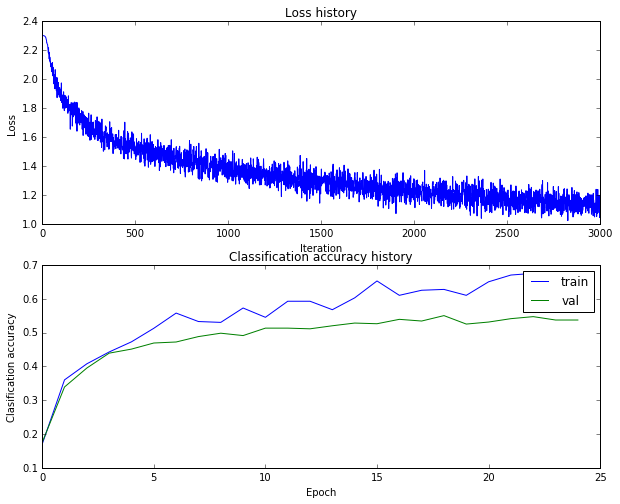

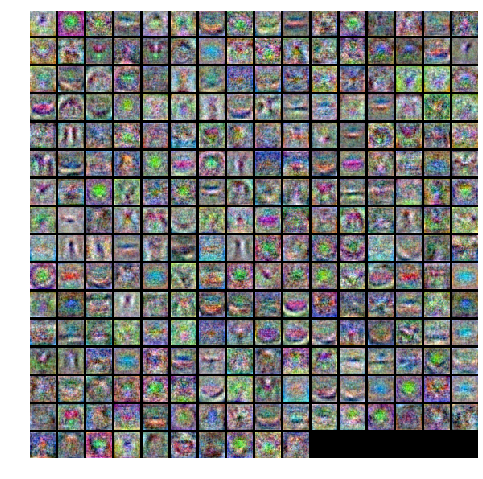

Validation accuracy:  0.544
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 250 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.302965
iteration 100 / 3000: loss 1.903675
iteration 200 / 3000: loss 1.643994
iteration 300 / 3000: loss 1.599170
iteration 400 / 3000: loss 1.576825
iteration 500 / 3000: loss 1.537765
iteration 600 / 3000: loss 1.407359
iteration 700 / 3000: loss 1.410363
iteration 800 / 3000: loss 1.384930
iteration 900 / 3000: loss 1.382870
iteration 1000 / 3000: loss 1.360798
iteration 1100 / 3000: loss 1.367923
iteration 1200 / 3000: loss 1.301148
iteration 1300 / 3000: loss 1.285661
iteration 1400 / 3000: loss 1.293541
iteration 1500 / 3000: loss 1.250195
iteration 1600 / 3000: loss 1.342885
iteration 1700 / 3000: loss 1.227827
iteration 1800 / 3000: loss 1.298659
iteration 1900 / 3000: loss 1.353977
iteration 2000 / 3000: loss 1.263276
iterati

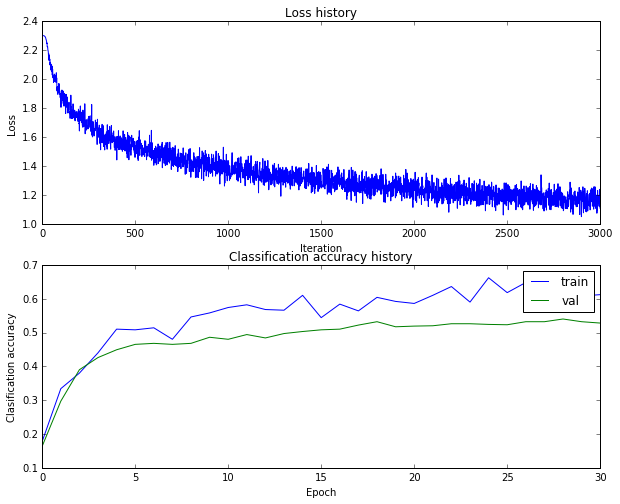

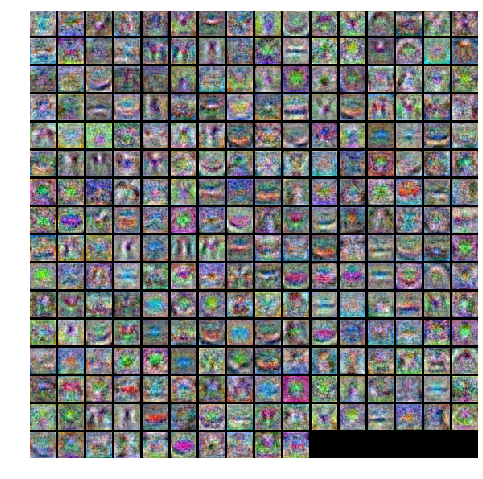

Validation accuracy:  0.534
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 1000
                           and batch size = 50
iteration 0 / 1000: loss 2.303077
iteration 100 / 1000: loss 2.049863
iteration 200 / 1000: loss 1.885741
iteration 300 / 1000: loss 1.726980
iteration 400 / 1000: loss 1.736681
iteration 500 / 1000: loss 1.533424
iteration 600 / 1000: loss 1.746407
iteration 700 / 1000: loss 1.807010
iteration 800 / 1000: loss 1.383647
iteration 900 / 1000: loss 1.346569


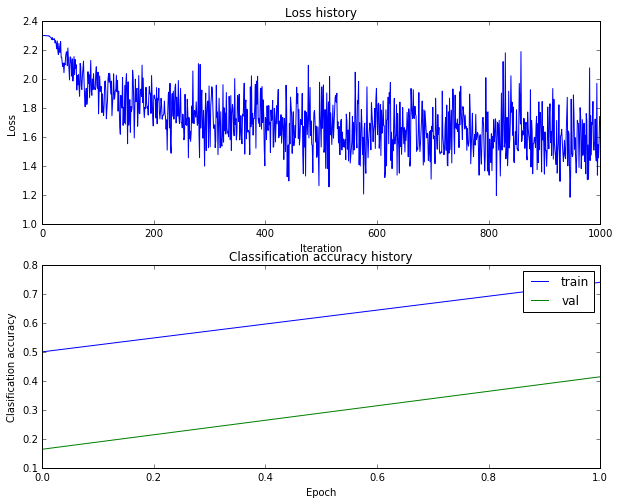

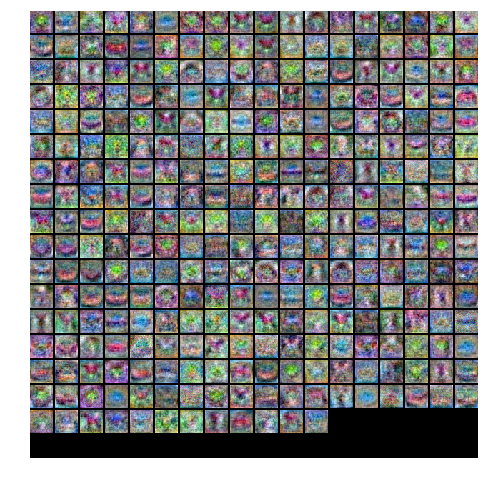

Validation accuracy:  0.41
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 1000
                           and batch size = 100
iteration 0 / 1000: loss 2.303000
iteration 100 / 1000: loss 1.676194
iteration 200 / 1000: loss 1.795367
iteration 300 / 1000: loss 1.563073
iteration 400 / 1000: loss 1.483909
iteration 500 / 1000: loss 1.579132
iteration 600 / 1000: loss 1.701710
iteration 700 / 1000: loss 1.645597
iteration 800 / 1000: loss 1.591559
iteration 900 / 1000: loss 1.363484


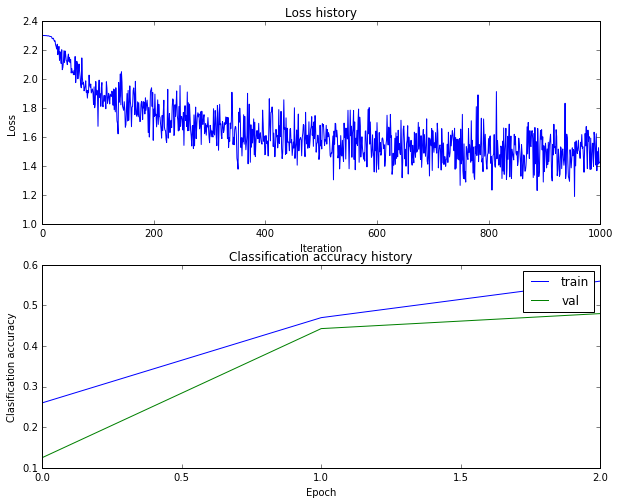

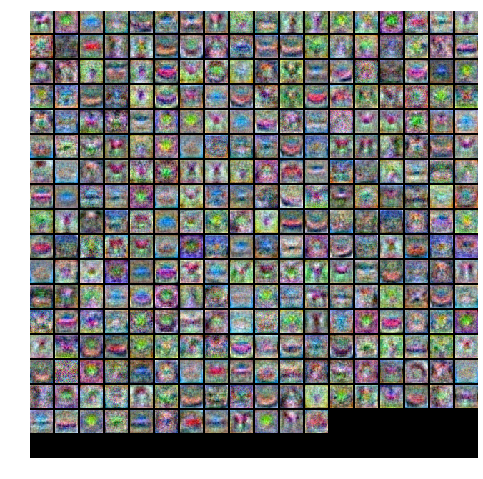

Validation accuracy:  0.476
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 1000
                           and batch size = 200
iteration 0 / 1000: loss 2.302997
iteration 100 / 1000: loss 1.937854
iteration 200 / 1000: loss 1.868722
iteration 300 / 1000: loss 1.660906
iteration 400 / 1000: loss 1.547846
iteration 500 / 1000: loss 1.528077
iteration 600 / 1000: loss 1.421181
iteration 700 / 1000: loss 1.313743
iteration 800 / 1000: loss 1.346759
iteration 900 / 1000: loss 1.359251


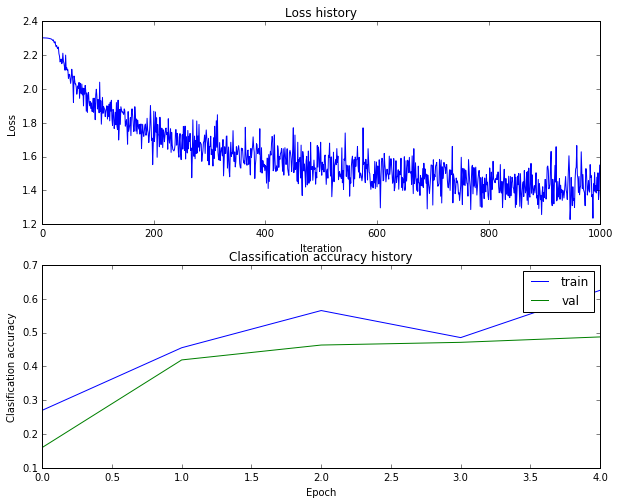

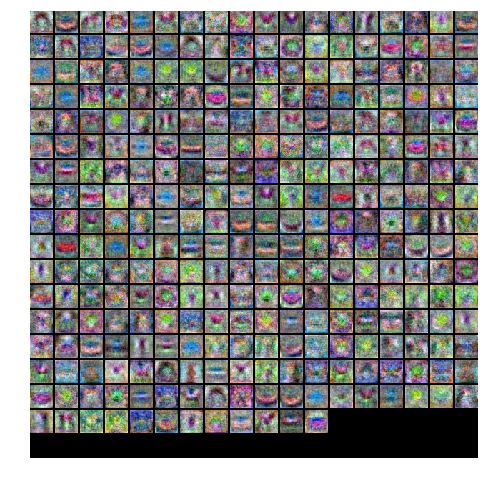

Validation accuracy:  0.491
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 1000
                           and batch size = 300
iteration 0 / 1000: loss 2.303053
iteration 100 / 1000: loss 1.941458
iteration 200 / 1000: loss 1.803933
iteration 300 / 1000: loss 1.654118
iteration 400 / 1000: loss 1.549828
iteration 500 / 1000: loss 1.434257
iteration 600 / 1000: loss 1.498618
iteration 700 / 1000: loss 1.488039
iteration 800 / 1000: loss 1.307221
iteration 900 / 1000: loss 1.463978


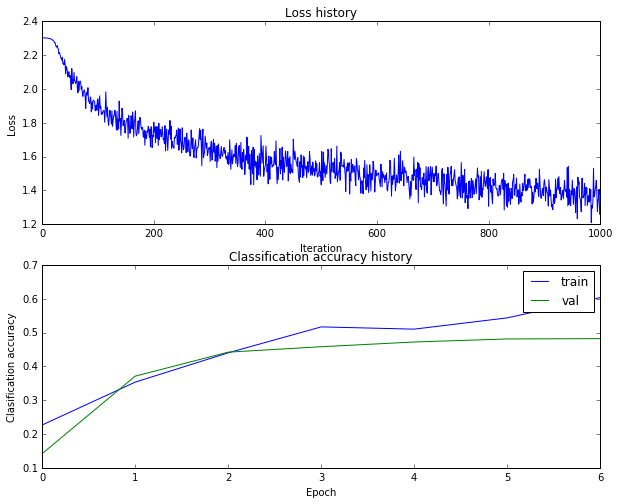

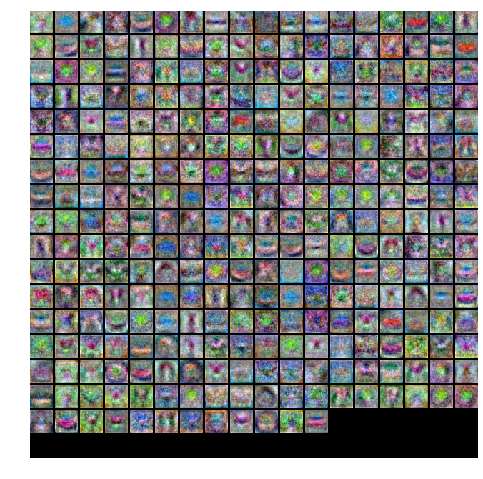

Validation accuracy:  0.491
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 1000
                           and batch size = 400
iteration 0 / 1000: loss 2.303009
iteration 100 / 1000: loss 1.879920
iteration 200 / 1000: loss 1.721713
iteration 300 / 1000: loss 1.627430
iteration 400 / 1000: loss 1.474880
iteration 500 / 1000: loss 1.511334
iteration 600 / 1000: loss 1.467027
iteration 700 / 1000: loss 1.525289
iteration 800 / 1000: loss 1.352322
iteration 900 / 1000: loss 1.399477


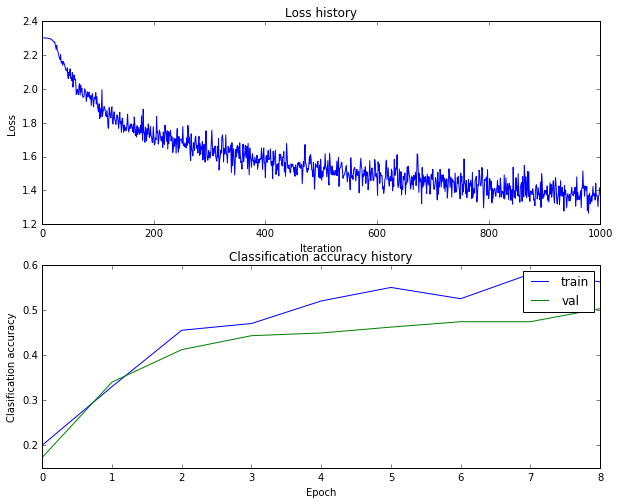

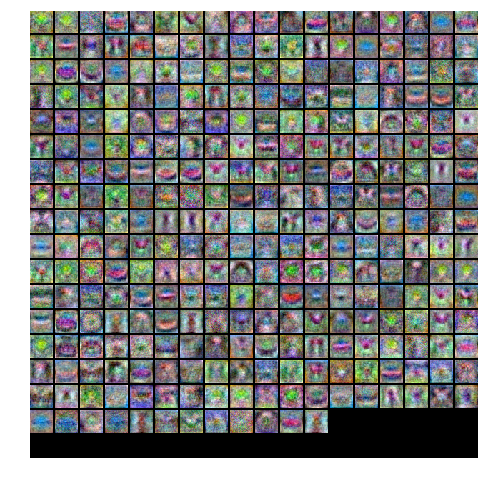

Validation accuracy:  0.497
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 1000
                           and batch size = 500
iteration 0 / 1000: loss 2.303059
iteration 100 / 1000: loss 1.841142
iteration 200 / 1000: loss 1.693497
iteration 300 / 1000: loss 1.656072
iteration 400 / 1000: loss 1.442458
iteration 500 / 1000: loss 1.521976
iteration 600 / 1000: loss 1.444938
iteration 700 / 1000: loss 1.357613
iteration 800 / 1000: loss 1.431662
iteration 900 / 1000: loss 1.377147


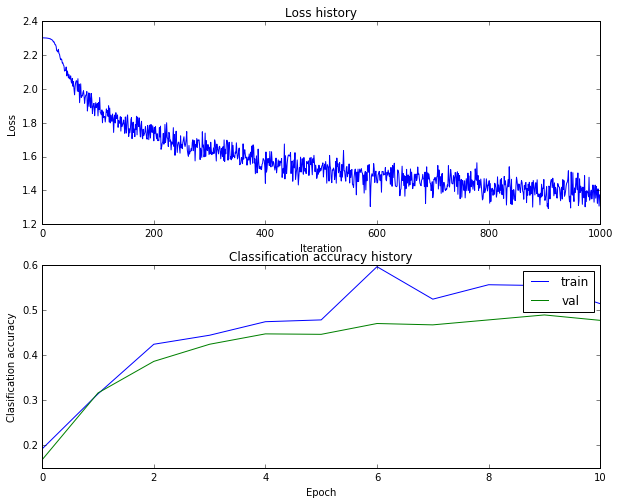

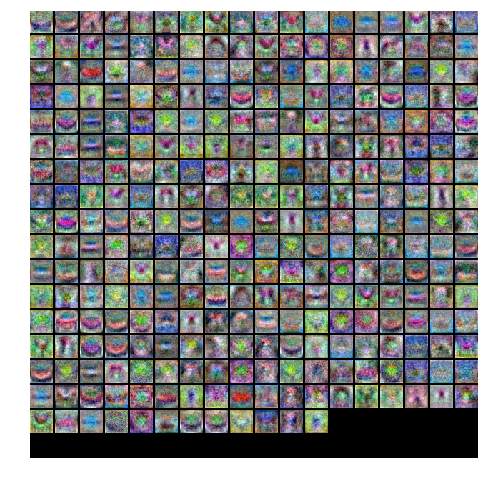

Validation accuracy:  0.498
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 3000
                           and batch size = 50
iteration 0 / 3000: loss 2.303081
iteration 100 / 3000: loss 2.006303
iteration 200 / 3000: loss 1.992317
iteration 300 / 3000: loss 1.557431
iteration 400 / 3000: loss 1.633582
iteration 500 / 3000: loss 1.536996
iteration 600 / 3000: loss 1.761536
iteration 700 / 3000: loss 1.645775
iteration 800 / 3000: loss 1.551062
iteration 900 / 3000: loss 1.506958
iteration 1000 / 3000: loss 1.395714
iteration 1100 / 3000: loss 1.349670
iteration 1200 / 3000: loss 1.942485
iteration 1300 / 3000: loss 1.291032
iteration 1400 / 3000: loss 1.535626
iteration 1500 / 3000: loss 1.727025
iteration 1600 / 3000: loss 1.588359
iteration 1700 / 3000: loss 1.456387
iteration 1800 / 3000: loss 1.420965
iteration 1900 / 3000: loss 1.130964
iteration 2000 / 3000: loss 1.311554
iteratio

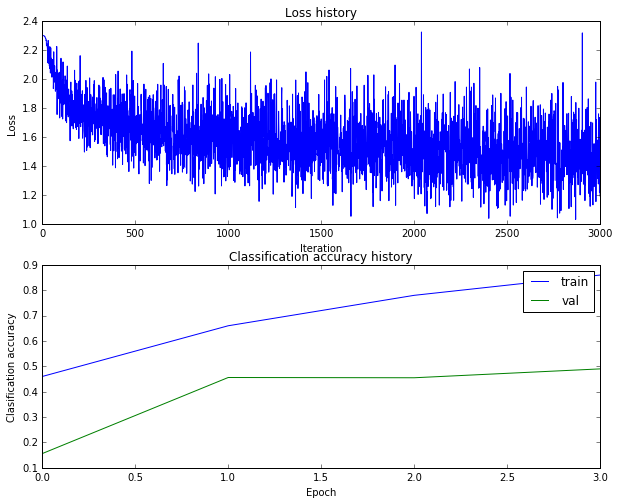

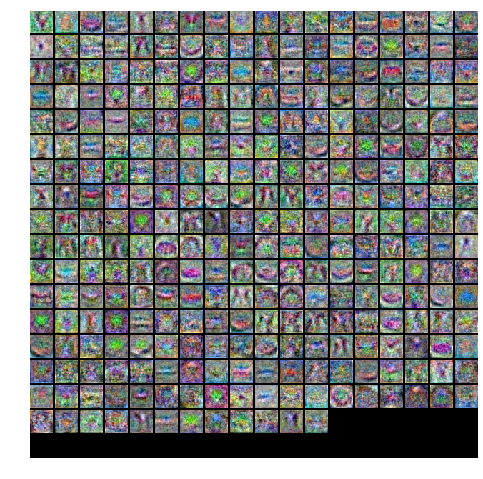

Validation accuracy:  0.463
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 3000
                           and batch size = 100
iteration 0 / 3000: loss 2.303019
iteration 100 / 3000: loss 1.937234
iteration 200 / 3000: loss 1.837607
iteration 300 / 3000: loss 1.402779
iteration 400 / 3000: loss 1.494661
iteration 500 / 3000: loss 1.649727
iteration 600 / 3000: loss 1.350527
iteration 700 / 3000: loss 1.540480
iteration 800 / 3000: loss 1.526323
iteration 900 / 3000: loss 1.461871
iteration 1000 / 3000: loss 1.667571
iteration 1100 / 3000: loss 1.545581
iteration 1200 / 3000: loss 1.405829
iteration 1300 / 3000: loss 1.391930
iteration 1400 / 3000: loss 1.359851
iteration 1500 / 3000: loss 1.424519
iteration 1600 / 3000: loss 1.548433
iteration 1700 / 3000: loss 1.444494
iteration 1800 / 3000: loss 1.415381
iteration 1900 / 3000: loss 1.576884
iteration 2000 / 3000: loss 1.211565
iterati

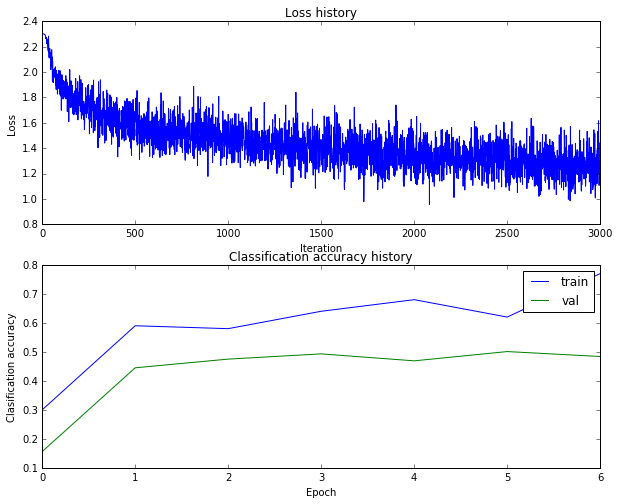

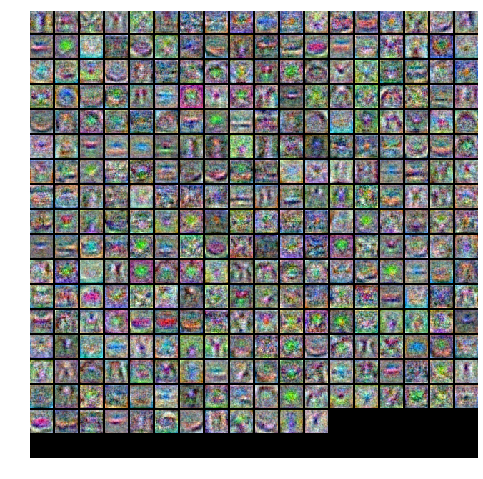

Validation accuracy:  0.503
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 3000
                           and batch size = 200
iteration 0 / 3000: loss 2.302997
iteration 100 / 3000: loss 1.925090
iteration 200 / 3000: loss 1.773538
iteration 300 / 3000: loss 1.644679
iteration 400 / 3000: loss 1.656591
iteration 500 / 3000: loss 1.542053
iteration 600 / 3000: loss 1.326283
iteration 700 / 3000: loss 1.501521
iteration 800 / 3000: loss 1.499698
iteration 900 / 3000: loss 1.504037
iteration 1000 / 3000: loss 1.381095
iteration 1100 / 3000: loss 1.238784
iteration 1200 / 3000: loss 1.366342
iteration 1300 / 3000: loss 1.436543
iteration 1400 / 3000: loss 1.234228
iteration 1500 / 3000: loss 1.185404
iteration 1600 / 3000: loss 1.267048
iteration 1700 / 3000: loss 1.244640
iteration 1800 / 3000: loss 1.159682
iteration 1900 / 3000: loss 1.207524
iteration 2000 / 3000: loss 1.359741
iterati

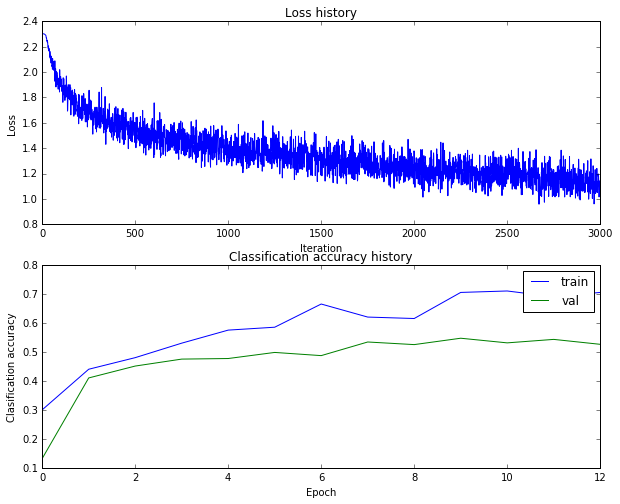

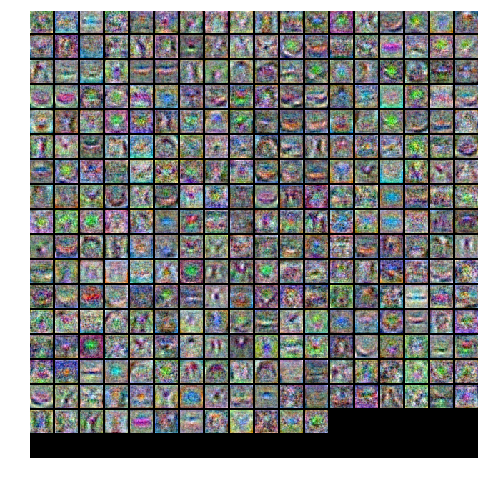

Validation accuracy:  0.533
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 3000
                           and batch size = 300
iteration 0 / 3000: loss 2.303046
iteration 100 / 3000: loss 1.951142
iteration 200 / 3000: loss 1.758642
iteration 300 / 3000: loss 1.710703
iteration 400 / 3000: loss 1.648358
iteration 500 / 3000: loss 1.575476
iteration 600 / 3000: loss 1.546976
iteration 700 / 3000: loss 1.463763
iteration 800 / 3000: loss 1.546764
iteration 900 / 3000: loss 1.386606
iteration 1000 / 3000: loss 1.498068
iteration 1100 / 3000: loss 1.367966
iteration 1200 / 3000: loss 1.401286
iteration 1300 / 3000: loss 1.282132
iteration 1400 / 3000: loss 1.312931
iteration 1500 / 3000: loss 1.170672
iteration 1600 / 3000: loss 1.340434
iteration 1700 / 3000: loss 1.363795
iteration 1800 / 3000: loss 1.302567
iteration 1900 / 3000: loss 1.286633
iteration 2000 / 3000: loss 1.158769
iterati

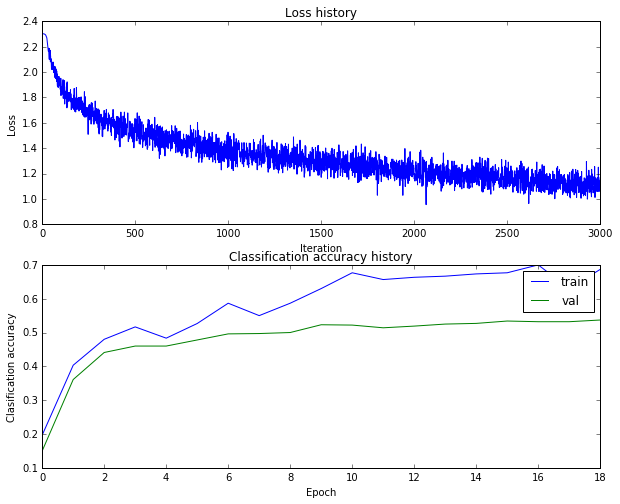

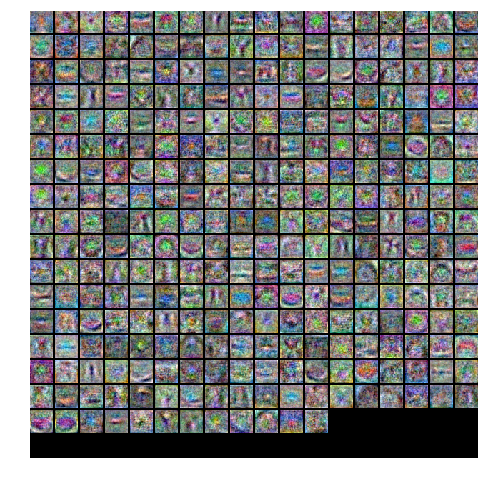

Validation accuracy:  0.54
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 3000
                           and batch size = 400
iteration 0 / 3000: loss 2.303089
iteration 100 / 3000: loss 1.878449
iteration 200 / 3000: loss 1.753740
iteration 300 / 3000: loss 1.629362
iteration 400 / 3000: loss 1.630311
iteration 500 / 3000: loss 1.553125
iteration 600 / 3000: loss 1.388362
iteration 700 / 3000: loss 1.315722
iteration 800 / 3000: loss 1.533878
iteration 900 / 3000: loss 1.346179
iteration 1000 / 3000: loss 1.363049
iteration 1100 / 3000: loss 1.398558
iteration 1200 / 3000: loss 1.354284
iteration 1300 / 3000: loss 1.344567
iteration 1400 / 3000: loss 1.344772
iteration 1500 / 3000: loss 1.248663
iteration 1600 / 3000: loss 1.297029
iteration 1700 / 3000: loss 1.067115
iteration 1800 / 3000: loss 1.266140
iteration 1900 / 3000: loss 1.106575
iteration 2000 / 3000: loss 1.177908
iteratio

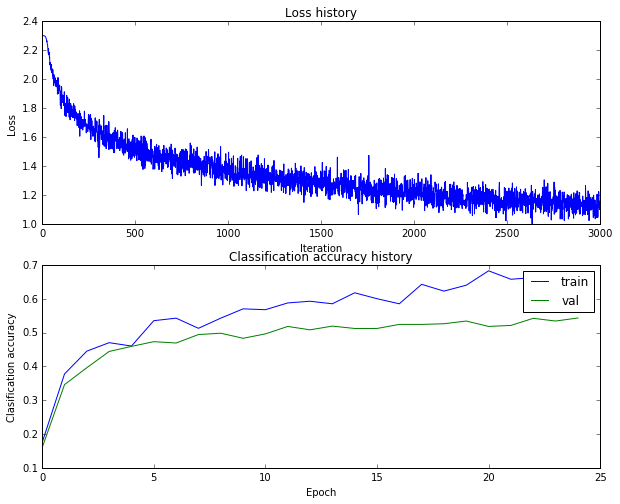

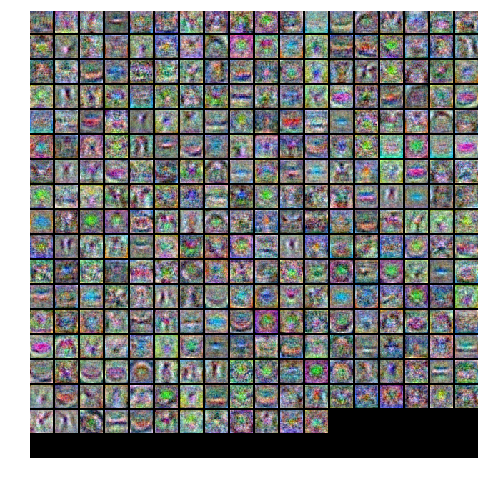

Validation accuracy:  0.537
Training learning rate = 0.001 and regularization strength = 0.1
                           and Size of Hidden layer = 300 and number iterations = 3000
                           and batch size = 500
iteration 0 / 3000: loss 2.302964
iteration 100 / 3000: loss 1.824279
iteration 200 / 3000: loss 1.665426
iteration 300 / 3000: loss 1.632722
iteration 400 / 3000: loss 1.599356
iteration 500 / 3000: loss 1.528677
iteration 600 / 3000: loss 1.493332
iteration 700 / 3000: loss 1.466397
iteration 800 / 3000: loss 1.453185
iteration 900 / 3000: loss 1.413254
iteration 1000 / 3000: loss 1.377060
iteration 1100 / 3000: loss 1.327031
iteration 1200 / 3000: loss 1.364543
iteration 1300 / 3000: loss 1.310657
iteration 1400 / 3000: loss 1.364993
iteration 1500 / 3000: loss 1.256208
iteration 1600 / 3000: loss 1.270658
iteration 1700 / 3000: loss 1.236269
iteration 1800 / 3000: loss 1.268257
iteration 1900 / 3000: loss 1.199108
iteration 2000 / 3000: loss 1.155791
iterati

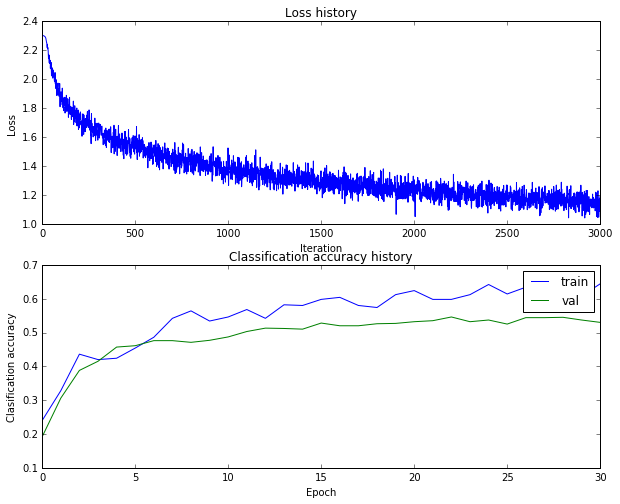

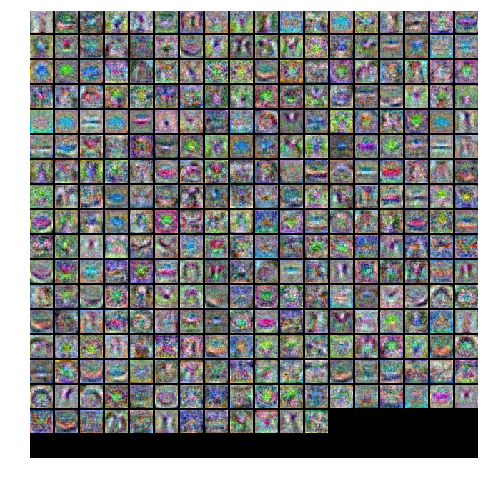

Validation accuracy:  0.541
best validation accuracy achieved during cross-validation: 0.546000


In [11]:
best_net = None # store the best model into this 

learning_rates = [1e-3]
regularization_strengths = [0.1]#, 0.25, 0.5, 7.5]
hidden_layer_sizes = [50, 100, 150, 200, 250, 300]
num_iterations = [3000, 5000]
batch_sizes = [200, 300, 400, 500, 600]

results = {}
best_val = -1   # The highest validation accuracy that we have seen so far.
best_net = None # The two later neural net object that achieved the highest validation rate.

#################################################################################
# TODO: Tune hyperparameters using the validation set. Store your best trained  #
# model in best_net.                                                            #
#                                                                               #
# To help debug your network, it may help to use visualizations similar to the  #
# ones we used above; these visualizations will have significant qualitative    #
# differences from the ones we saw above for the poorly tuned network.          #
#                                                                               #
# Tweaking hyperparameters by hand can be fun, but you might find it useful to  #
# write code to sweep through possible combinations of hyperparameters          #
# automatically like we did on the previous exercises.                          #
#################################################################################
for reg in regularization_strengths:
    for hidden_size in hidden_layer_sizes:
        for lr in learning_rates:
            for num_iters in num_iterations:
                for batch_size in batch_sizes:
                    print("Training learning rate = {lr} and regularization strength = {reg}\n\
                           and Size of Hidden layer = {hidden_size} and number iterations = {num_iters}\n\
                           and batch size = {batch_size}"
                          .format(lr=lr, reg=reg, hidden_size=hidden_size, 
                                  num_iters=num_iters, batch_size=batch_size))
                    net = TwoLayerNet(input_size, hidden_size, num_classes)
                    stats = net.train(X_train, y_train, X_val, y_val,
                                      num_iters=num_iters, batch_size=batch_size,
                                      learning_rate=lr, learning_rate_decay=0.95,
                                      reg=reg, verbose=True)

                    # Plot the loss function and train / validation accuracies
                    plt.subplot(2, 1, 1)
                    plt.plot(stats['loss_history'])
                    plt.title('Loss history')
                    plt.xlabel('Iteration')
                    plt.ylabel('Loss')

                    plt.subplot(2, 1, 2)
                    plt.plot(stats['train_acc_history'], label='train')
                    plt.plot(stats['val_acc_history'], label='val')
                    plt.title('Classification accuracy history')
                    plt.xlabel('Epoch')
                    plt.ylabel('Clasification accuracy')
                    plt.legend()
                    plt.show()
                    
                    show_net_weights(net)

                    y_train_pred = net.predict(X_train)
                    y_val_pred = net.predict(X_val)
                    train_accuracy = np.mean(y_train == y_train_pred)
                    val_accuracy = np.mean(y_val == y_val_pred)
                    print 'Validation accuracy: ', val_accuracy
                    results[(lr, reg, hidden_size, num_iters, batch_size)] = (train_accuracy, val_accuracy)
                    if val_accuracy > best_val:
                        best_val = val_accuracy
                        best_net = net
            
print 'best validation accuracy achieved during cross-validation: %f' % best_val
#################################################################################
#                               END OF YOUR CODE                                #
#################################################################################

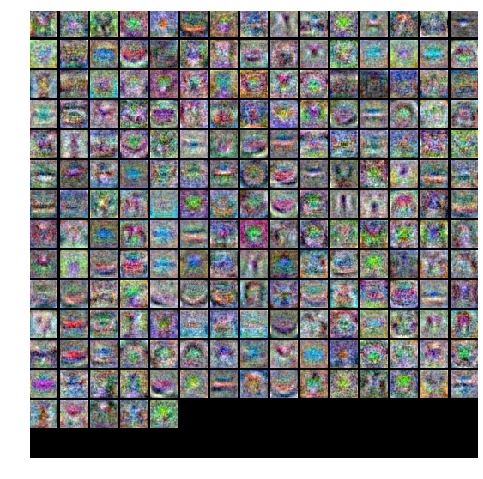

In [12]:
# visualize the weights of the best network
show_net_weights(best_net)

# Run on the test set
When you are done experimenting, you should evaluate your final trained network on the test set; you should get above 48%.

**We will give you extra bonus point for every 1% of accuracy above 52%.**

In [13]:
test_acc = (best_net.predict(X_test) == y_test).mean()
print 'Test accuracy: ', test_acc

Test accuracy:  0.53


In [14]:
results

{(0.001, 0.1, 50, 1000, 50): (0.42995918367346941, 0.42599999999999999),
 (0.001, 0.1, 50, 1000, 100): (0.46993877551020408, 0.44900000000000001),
 (0.001, 0.1, 50, 1000, 200): (0.49161224489795918, 0.48299999999999998),
 (0.001, 0.1, 50, 1000, 300): (0.4989387755102041, 0.48999999999999999),
 (0.001, 0.1, 50, 1000, 400): (0.50453061224489792, 0.48299999999999998),
 (0.001, 0.1, 50, 1000, 500): (0.49628571428571427, 0.49399999999999999),
 (0.001, 0.1, 50, 3000, 50): (0.48487755102040814, 0.46700000000000003),
 (0.001, 0.1, 50, 3000, 100): (0.53838775510204084, 0.496),
 (0.001, 0.1, 50, 3000, 200): (0.55708163265306121, 0.504),
 (0.001, 0.1, 50, 3000, 300): (0.56565306122448977, 0.5),
 (0.001, 0.1, 50, 3000, 400): (0.5610612244897959, 0.5),
 (0.001, 0.1, 50, 3000, 500): (0.55763265306122445, 0.503),
 (0.001, 0.1, 100, 1000, 50): (0.45518367346938776, 0.44800000000000001),
 (0.001, 0.1, 100, 1000, 100): (0.48267346938775513, 0.47499999999999998),
 (0.001, 0.1, 100, 1000, 200): (0.5034081